In [ ]:
from notebooks import *

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


The potoo.default_magic_magic extension is already loaded. To reload it, use:
  %reload_ext potoo.default_magic_magic


In [ ]:
# Default figsize for spectros
figsize(aspect=1/8);

In [ ]:
# Load model
#   - Chosen via notebooks/20180629_eval.ipynb (local runs) -> Train/test scores
search = Search.load_v0(

    # 'eval-na-dan170',
    #     'split_i=0,train=2693,test=674,classes=170', 'n_species=170,n_recs=1.0',
    #         'cls=logreg_ovr,solver=liblinear,C=0.1,class_weight=balanced',  # Not std
    #         'cls=std-sgdlog,alpha=0.1,class_weight=balanced',  # std [Re-run locally to get an n_species=170]

    'comp-l1-l2-na-ca',

        # 'split_i=0,train=28164,test=7042,classes=331', 'n_species=9,n_recs=1.0',
        #     'cls=logreg_ovr,solver=liblinear,C=1,class_weight=balanced',
        #     'cls=logreg_ovr_l1,solver=liblinear,C=1,class_weight=balanced',
        #     'cls=ovr-logreg_ovr,solver=liblinear,C=1,class_weight=balanced',
        #     'cls=ovr-logreg_ovr_l1,solver=liblinear,C=1,class_weight=balanced',

        # 'split_i=0,train=28164,test=7042,classes=331', 'n_species=82,n_recs=1.0',
        #     'cls=logreg_ovr,solver=liblinear,C=0.1,class_weight=balanced',
        #     'cls=logreg_ovr_l1,solver=liblinear,C=0.3,class_weight=balanced',
        #     'cls=ovr-logreg_ovr,solver=liblinear,C=0.01,class_weight=balanced',
        #     'cls=ovr-logreg_ovr_l1,solver=liblinear,C=0.1,class_weight=balanced',

        # 'split_i=0,train=28164,test=7042,classes=331', 'n_species=331,n_recs=1.0',
        #     'cls=ovr-logreg_ovr,solver=liblinear,C=0.01,class_weight=balanced',
        #     'cls=ovr-logreg_ovr_l1,solver=liblinear,C=0.001,class_weight=balanced',

        'split_i=0,train=34875,test=331,classes=331', 'n_species=331,n_recs=1.0',
            'cls=ovr-logreg_ovr,solver=liblinear,C=0.001,class_weight=balanced',

)
display(
    search,
    search.classifier_,
    len(search.classifier_.classes_),
)

Search(
  n_species=331,
  n_recs=1.0,
  classifier='cls: ovr-logreg_ovr,solver: liblinear,C: 0.001,class_weight: balanced',
  random_state=0,
  projection=Projection(
    features=Features(
      load=Load(channels=1, sample_rate=22050, sample_width_bit=16, cache_audio=True),
      sample_rate=22050,
      f_min=1000,
      f_bins=40,
      hop_length=256,
      frame_length=512,
      frame_window='hann',
      patch_length=4
    ),
    skm_fit_max_t=600000,
    k=500,
    variance_explained=0.99,
    do_pca=True,
    pca_whiten=True,
    standardize=False,
    normalize=False,
    agg_funs=['mean', 'std', 'max']
  )
)

OneVsRestClassifier(estimator=LogisticRegression(C=0.001, class_weight='balanced', dual=False,
          fit_intercept=True, intercept_scaling=1, max_iter=100,
          multi_class='ovr', n_jobs=1, penalty='l2', random_state=0,
          solver='liblinear', tol=0.0001, verbose=0, warm_start=False),
          n_jobs=45)

331

In [ ]:
# HACK FIXME Why doesn't search.projection.skm_ exist after unpickle?
projection = Projection.load('peterson-v0-26bae1c', features=Features(load=Load()))
features = projection.features
load = features.load
search.projection = projection
# These both work...
joblib_loads(joblib_dumps(projection)).skm_
joblib_loads(joblib_dumps(search)).projection.skm_

[23:05:46.323] DEBUG  Projection.load
  path: /Users/danb/hack/bubo/features/data/models/projection/peterson-v0-26bae1c.pkl


In [ ]:
user_recs = load_app_recs(projection,
    # n=10,
)
display(
    df_summary(user_recs).T,
    df_value_counts(user_recs),
    user_recs[:10],
)

[23:05:50.370] DEBUG  Load.audio:in
  len(recs): 164
  len(recs) per dataset: {recordings: 164}
[                                                                                          ] | 0% Completed |  0.0s

[                                                                                          ] | 0% Completed |  0.1s

[##                                                                                        ] | 2% Completed |  0.2s

[###############                                                                           ] | 17% Completed |  0.3s

[####################################################                                      ] | 58% Completed |  0.4s

[##########################################################################################] | 100% Completed |  0.5s

[23:05:50.939] DEBUG  Load.audio:out
  len(audio): 164


[23:05:52.183] WARN   Dropped 1 recs with duplicate audio_id


,recorded_at,dataset,species,species_com_name,species_query,duration_s,samples_mb,samples_n,basename,species_longhand,audio_sha,id,path,audio,feat
audio_id,,,,,,,,,,,,,,,
20171007-c6f4,2017-10-07 15:18:04,recordings,BEWR,Bewick's Wren,BEWR,30.3,1.28,668860,BEWR Bewicks Wren 2 (Coyote Hills parking lot) 2,Bewick's Wren - BEWR,c6f4dae698ffb4a89fc86f16534acc42cd22ffa9,recordings/BEWR Bewicks Wren 2 (Coyote Hills parking lot) 2,recordings/BEWR Bewicks Wren 2 (Coyote Hills parking lot) 2.wav,"box(unbox=recordings/BEWR Bewicks Wren 2 (Coyote Hills parking lot) 2: 1 channels, 16 bit, sampled @ 22.05 kHz, 30.334s long)",[ 4.983e-02 -9.263e-03 -5.601e-02 -3.380e-02 1.946e-02 9.371e-02 2.812e-02 -1.783e-02 8.781e-02 -8.130e-02\n -2.813e-02 -4.650e-02 -4.735e-02 -7.861e-02 -5.890e-02 1.4...
20171007-c6f4,2017-10-07 15:18:04,recordings,BEWR,Bewick's Wren,BEWR,30.3,1.28,668860,BEWR Bewicks Wren 2 (Coyote Hills parking lot),Bewick's Wren - BEWR,c6f4dae698ffb4a89fc86f16534acc42cd22ffa9,recordings/BEWR Bewicks Wren 2 (Coyote Hills parking lot),recordings/BEWR Bewicks Wren 2 (Coyote Hills parking lot).wav,"box(unbox=recordings/BEWR Bewicks Wren 2 (Coyote Hills parking lot): 1 channels, 16 bit, sampled @ 22.05 kHz, 30.334s long)",[ 4.983e-02 -9.263e-03 -5.601e-02 -3.380e-02 1.946e-02 9.371e-02 2.812e-02 -1.783e-02 8.781e-02 -8.130e-02\n -2.813e-02 -4.650e-02 -4.735e-02 -7.861e-02 -5.890e-02 1.4...


[23:05:52.229] DEBUG  Features.spectros:in
  len(recs): 163
  len(recs) per dataset: {recordings: 163}
  sum(duration_h): 3.29
  sum(samples_mb): 498.0
  sum(samples_n): 261204420
[                                                                                          ] | 0% Completed |  0.0s

[#                                                                                         ] | 1% Completed |  0.1s

[###########################                                                               ] | 30% Completed |  0.2s

[#################################################                                         ] | 54% Completed |  0.3s

[#################################################################                         ] | 72% Completed |  0.4s

[####################################################################################      ] | 93% Completed |  0.5s

[##########################################################################################] | 100% Completed |  0.6s

[23:05:52.881] DEBUG  Features.spectros:out
  (f, sum(t)): [40, 1020094]


,,,,,,,,min,25%,50%,75%,max
,dtype,sizeof,len,count,nunique,mean,std,,,,,
audio_id,object,11410,163,163,163.0,NaN,NaN,20160709-1e8c,20160910-3543,20171007-a787,20180513-1a88,20180805-60c3
recorded_at,datetime64[ns],1304,163,163,163.0,NaN,NaN,2016-07-09 18:38:51,2016-09-10 21:27:02,2017-10-07 15:18:55,2018-05-13 17:35:14,2018-08-05 15:57:16
dataset,object,10921,163,163,1.0,NaN,NaN,recordings,recordings,recordings,recordings,recordings
species,object,9943,163,163,35.0,NaN,NaN,AMBI,RTHA,_UNK,_UNK,_UNK
species_com_name,object,10933,163,163,35.0,NaN,NaN,American Bittern,Red-tailed Hawk,Unknown,Unknown,Wilson's Warbler
species_query,object,9943,163,163,35.0,NaN,NaN,AMBI,RTHA,_UNK,_UNK,_UNK
duration_s,float64,1304,163,163,158.0,NaN,NaN,2.75,19.1,48.8,90.8,691
samples_mb,float64,1304,163,163,158.0,NaN,NaN,0.115,0.804,2.05,3.82,29
samples_n,int64,1304,163,163,158.0,NaN,NaN,60544,421573,1076243,2002707,15229220


,dataset,n,species,n,species_com_name,n,species_query,n,duration_s,n,samples_mb,n,samples_n,n,species_longhand,n
0,recordings,163,_UNK,104,Unknown,104,_UNK,104,3.85,2,0.161,2,84480,2,Unknown - _UNK,104
1,,,RTHA,4,Common Raven,4,RTHA,4,3.94,2,0.208,2,108928,2,Common Raven - CORA,4
2,,,CORA,4,Red-tailed Hawk,4,CORA,4,3.83,2,0.166,2,86784,2,Red-tailed Hawk - RTHA,4
3,,,BEWR,3,Wilson's Warbler,3,BEWR,3,4.94,2,0.162,2,155776,2,Bewick's Wren - BEWR,3
4,,,SPTO,3,Orange-crowned Warbler,3,SPTO,3,7.06,2,0.297,2,84864,2,Spotted Towhee - SPTO,3
5,,,WIWA,3,Bewick's Wren,3,WIWA,3,162.00,1,0.147,1,1320202,1,Wilson's Warbler - WIWA,3
6,,,WCSP,3,Spotted Towhee,3,WCSP,3,29.80,1,0.247,1,83968,1,White-crowned Sparrow - WCSP,3
7,,,OCWA,3,White-crowned Sparrow,3,OCWA,3,56.40,1,0.185,1,199168,1,Orange-crowned Warbler - OCWA,3
8,,,FOSP,2,Black Phoebe,2,FOSP,2,88.20,1,0.159,1,2044677,1,Fox Sparrow - FOSP,2
9,,,RWBL,2,Marsh Wren,2,RWBL,2,59.90,1,5.800,1,95232,1,Marsh Wren - MAWR,2


,recorded_at,dataset,species,species_com_name,species_query,duration_s,samples_mb,samples_n,basename,species_longhand,audio_sha,id,path,audio,feat,spectro
audio_id,,,,,,,,,,,,,,,,
20160709-1e8c,2016-07-09 19:04:03,recordings,CALT,California Towhee,CALT,43.2,1.820,951746,CALT cal towhee,California Towhee - CALT,1e8c9cfe8f48560aa30173bb9f20aee30e7ecd71,recordings/CALT cal towhee,recordings/CALT cal towhee.wav,"box(unbox=recordings/CALT cal towhee: 1 channels, 16 bit, sampled @ 22.05 kHz, 43.163s long)",[ 2.035e-03 6.529e-02 2.609e-01 -8.920e-02 7.727e-02 2.055e-01 2.770e-02 -5.686e-02 4.625e-01 -4.459e-02\n -2.317e-01 1.583e-01 -7.546e-03 -1.656e-01 2.748e-02 -1.4...,
20160709-228d,2016-07-09 20:51:51,recordings,RTHA,Red-tailed Hawk,RTHA,42.1,1.770,928934,"RTHA red tailed hawk, noise",Red-tailed Hawk - RTHA,228d2414340927d1c8193963959bb82a6681e6db,"recordings/RTHA red tailed hawk, noise","recordings/RTHA red tailed hawk, noise.wav","box(unbox=recordings/RTHA red tailed hawk, noise: 1 channels, 16 bit, sampled @ 22.05 kHz, 42.129s long)",[ 1.452e-01 -3.292e-02 6.948e-01 -2.057e-02 -1.251e-02 -2.576e-02 4.741e-02 -4.145e-01 1.621e-01 -1.482e-01\n -1.505e-01 1.070e-01 -3.720e-02 -8.035e-02 -5.857e-03 1.3...,
20160709-4bb7,2016-07-09 19:57:52,recordings,_UNK,Unknown,_UNK,59.9,2.520,1320202,Recording 0019,Unknown - _UNK,4bb7924a5092f24d2fede40c339479b1befb6ac0,recordings/Recording 0019,recordings/Recording 0019.wav,"box(unbox=recordings/Recording 0019: 1 channels, 16 bit, sampled @ 22.05 kHz, 59.873s long)",[ 4.733e-02 2.485e-02 1.041e-01 -2.679e-02 2.001e-02 3.011e-03 9.353e-02 -1.986e-02 9.155e-02 -9.730e-02\n -2.053e-01 3.033e-01 -8.698e-03 -9.605e-02 9.715e-02 1.5...,
20160709-4e73,2016-07-09 19:07:43,recordings,WCSP,White-crowned Sparrow,WCSP,21.9,0.923,483910,WCSP white crowned,White-crowned Sparrow - WCSP,4e73e2c74b271647b5406c5784b8af1fd609b8eb,recordings/WCSP white crowned,recordings/WCSP white crowned.wav,"box(unbox=recordings/WCSP white crowned: 1 channels, 16 bit, sampled @ 22.05 kHz, 21.946s long)",[ 2.455e-02 -1.062e-02 9.811e-01 -9.299e-02 4.945e-02 -5.597e-02 5.669e-02 -2.279e-01 4.159e-01 -7.791e-02\n -1.896e-01 1.582e-01 -4.445e-02 -9.104e-02 6.175e-02 -1.1...,
20160709-59d3,2016-07-09 18:53:03,recordings,RTHA,Red-tailed Hawk,RTHA,30.6,1.290,674360,RTHA red tailed hawk,Red-tailed Hawk - RTHA,59d360c416f841fdc19213c1943c73b39992e241,recordings/RTHA red tailed hawk,recordings/RTHA red tailed hawk.wav,"box(unbox=recordings/RTHA red tailed hawk: 1 channels, 16 bit, sampled @ 22.05 kHz, 30.583s long)",[ 2.229e-02 -1.745e-02 7.496e-01 -5.046e-02 -3.577e-02 -4.409e-02 2.941e-04 -2.590e-01 2.597e-01 2.174e-02\n -1.398e-01 -4.891e-02 -5.807e-03 -9.787e-02 -1.195e-01 -1.8...,
20160709-795e,2016-07-09 20:34:26,recordings,_UNK,Unknown,_UNK,71.2,2.990,1569411,unknown sparrow (song?),Unknown - _UNK,795e65fdd0566f69ddfaa13bae28c5e6fde0d3f6,recordings/unknown sparrow (song?),recordings/unknown sparrow (song?).wav,"box(unbox=recordings/unknown sparrow (song?): 1 channels, 16 bit, sampled @ 22.05 kHz, 71.175s long)",[ 1.549e-01 -4.838e-02 1.737e-01 2.306e-02 3.237e-04 -4.025e-02 1.242e-01 -8.359e-02 2.388e-01 -9.303e-02\n -2.223e-01 2.008e-02 -1.347e-01 -4.654e-02 -5.248e-02 3.6...,
20160709-81dc,2016-07-09 20:59:19,recordings,HAWO,Hairy Woodpecker,HAWO,59.3,2.490,1307828,HAWO hairy woodpecker (2),Hairy Woodpecker - HAWO,81dc45758f7932931a1072df74422793bb083cda,recordings/HAWO hairy woodpecker (2),recordings/HAWO hairy woodpecker (2).wav,"box(unbox=recordings/HAWO hairy woodpecker (2): 1 channels, 16 bit, sampled @ 22.05 kHz, 59.312s long)",[ 6.210e-02 -3.008e-02 9.021e-03 -5.638e-02 1.596e-02 -4.143e-02 6.790e-02 -2.643e-02 1.448e-01 -8.180e-02\n -9.243e-02 1.103e-01 -3.034e-02 -3.102e-02 6.833e-02 -1.6...,
20160709-8c26,2016-07-09 19:51:42,recordings,_UNK,Unknown,_UNK,72.1,3.030,1589856,Recording 0018,Unknown - _UNK,8c26390858462d8ccfad92be14e1758014f54c12,recordings/Recording 0018,recordings/Recording 0018.wav,"box(unbox=recording

In [ ]:
# TODO -> util (or model)
def rec_neighbors(projection, query_rec, search_recs, k=None, **kwargs):
    if k is None:
        k = len(search_recs)
    search_recs = search_recs.reset_index()
    feat = Search.X
    knn = sk.neighbors.NearestNeighbors(**kwargs).fit(feat(search_recs))  # TODO Fit once and reuse
    ([dist], [rec_i]) = knn.kneighbors(
        feat(pd.DataFrame([query_rec])),
        n_neighbors=k,
    )
    return (search_recs.loc[rec_i]
        .assign(dist=dist)
        .pipe(df_reorder_cols, first=['dist'])
    )

# Query against user recs

20180805-60c3  2018-08-05T15:57:16  BEWR  23.7s  BEWR - vollmer peak+be497da7


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,OATI,WBNU,RCKI,BEWR,SOSP,LISP,PUFI,SPTO,WIFL,HUVI,DEJU,AMRO,LASP,NAWA,RECR
p,0.0882,0.0777,0.0648,0.0629,0.0506,0.0471,0.0467,0.0461,0.0457,0.0394,0.0382,0.0348,0.0274,0.0218,0.0189


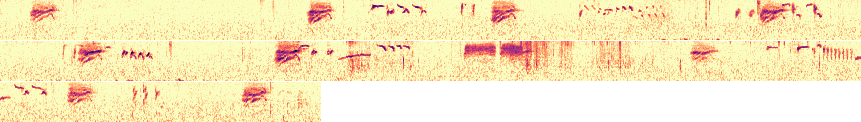

In [ ]:
query_rec = (user_recs
    .loc['20180805-60c3']  # BEWR
    .pipe(projection.slice_audio, 6.5)  # Re-denoise spectro
)
print(rec_str_line(query_rec))
display(rec_preds(query_rec, search, 15))
plot_spectro_micro(query_rec, features, wrap=True,
    # audio=True,
    # limit_s=60,
)

 43.9  20170819-8661  2017-08-19T16:27:21  _UNK  4.7s  UNK_20170819_092720


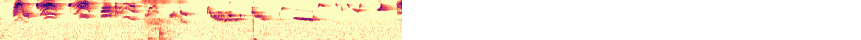

 45.0  20170514-94f6  2017-05-14T15:59:19  _UNK  127.8s  various (community garden by christopher playground)


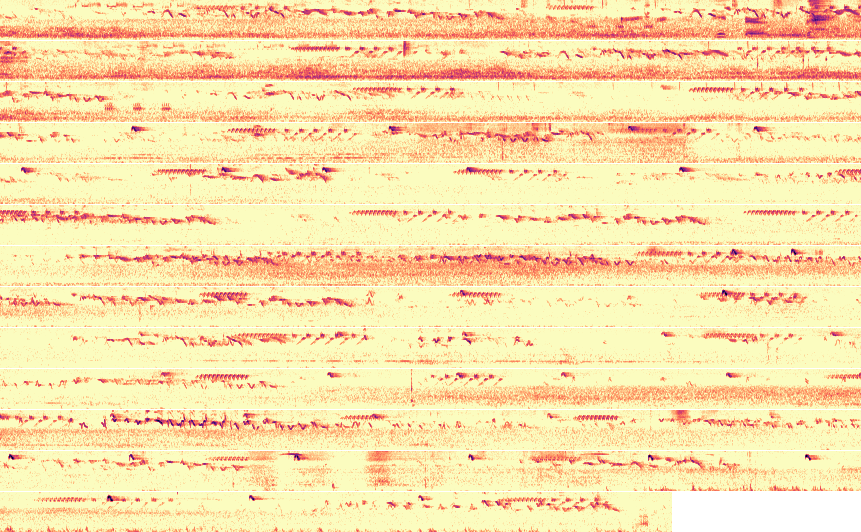

 45.7  20171007-602c  2017-10-07T15:20:39  BEWR  46.5s  BEWR Bewicks Wren (Coyote Hills parking lot)


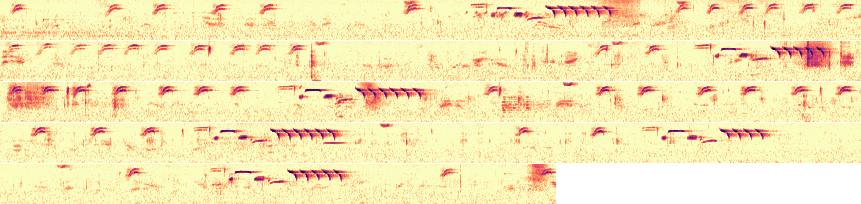

In [ ]:
for result in df_rows(
    rec_neighbors(projection, query_rec, user_recs)
    [:3]
):
    print(rec_str_line(result, ('dist', '%5.1f')))
    plot_spectro_micro(result, features,
        wrap=True,
        # audio=True,
    )

# Load xc recs

In [ ]:
# TODO Clean this up (how much complexity can we encapsulate and hide in functions vs. how much do we need to surface here?)

In [ ]:
# Load xc_meta (fast)
#   1. countries: Filter recs to these countries
#   2. species: Filter recs to these species
#   3. recs_at_least: Filter species to those with at least this many recs
#   4. num_species: Sample this many of the species
#   5. num_recs: Sample this many recs per species
inf = np.inf
# countries_k, com_names_k = 'na', 'us'      # 9.4k/400k -> 1.1k/60k -> 774/53k
# countries_k, com_names_k = 'na', 'ca'      # 9.4k/400k -> 1.1k/60k -> 334/35k
# countries_k, com_names_k = 'na', 'dan170'  # 9.4k/400k -> 1.1k/60k -> 170/3.4k
# countries_k, com_names_k = 'na', 'dan4'    # 9.4k/400k -> 1.1k/60k ->   4/2.2k (BEWR, HOWR, SOSP, SPTO)
countries_k, com_names_k = 'na', 'dan5'    # 9.4k/400k -> 1.1k/60k ->   5/2.3k (BEWR, HOWR, SOSP, SPTO, PSFL)
recs_at_least, num_species, num_recs =   0, inf, inf  # US[334/35k ->1.1k/60k -> 774/53k -> 774/53k   -> 743/53k]    # All US
# recs_at_least, num_species, num_recs = 100, 100, 100  # CA[334/35k -> 127/25k -> 100/21k -> 100/10k   -> 100/10k]
# recs_at_least, num_species, num_recs =  50, 100, 100  # CA[334/35k -> 224/32k -> 100/16k -> 100/ 9.0k -> 100/ 9.0k]
# recs_at_least, num_species, num_recs =   0, 100, 100  # CA[334/35k -> 334/35k -> 100/12k -> 100/ 6.8k ->  99/ 6.8k]
# recs_at_least, num_species, num_recs =   0, 168, 100  # CA[334/34k -> 334/34k -> 168/18k -> 168/11k   -> 167/11k]    # (old 'all')
# recs_at_least, num_species, num_recs =   0, 168,  20  # CA[334/34k -> 334/35k -> 168/18k -> 168/ 3.2k -> 167/ 3.2k]  # (old 'recs')
# recs_at_least, num_species, num_recs =  20, 168,  20  # CA[334/35k -> 296/35k -> 168/20k -> 168/ 3.4k -> 168/ 3.4k]  # Familiar set
# recs_at_least, num_species, num_recs =  20, 336,  20  # US[774/53k -> 528/51k -> 336/33k -> 336/ 6.7k -> 336/ 6.7k]  # Scale species
# recs_at_least, num_species, num_recs =  10, 168,  20  # CA[334/35k ->                                             ]  # Class imbalance
# recs_at_least, num_species, num_recs =   0, 168,  20  # CA[334/35k ->                                             ]  # Class imbalance
# recs_at_least, num_species, num_recs =   0, inf,  20  # dan170 for app_brainstorm_1
# recs_at_least, num_species, num_recs =  20, 50,  100  # Faster dev
# recs_at_least, num_species, num_recs =  20, 50,   50  # Faster dev
# recs_at_least, num_species, num_recs =  20, 50,   20  # Faster dev
# recs_at_least, num_species, num_recs =  20, 50,   10  # Faster dev
# recs_at_least, num_species, num_recs =  20, 50,    5  # Faster dev
get_recs_stats = lambda df: dict(sp=df.species.nunique(), recs=len(df))
puts_stats = lambda desc: partial(tap, f=lambda df: print('%-15s %12s (sp/recs)' % (desc, '%(sp)s/%(recs)s' % get_recs_stats(df))))
xc_meta = (xc.metadata
    .pipe(puts_stats('all'))
    # 1. countries: Filter recs to these countries
    [lambda df: df.country.isin(constants.countries[countries_k])]
    .pipe(puts_stats('countries'))
    # 2. species: Filter recs to these species
    [lambda df: df.species.isin(com_names_to_species(*com_names[com_names_k]))]
    .pipe(puts_stats('species'))
    # Omit not-downloaded recs (should be few within the selected countries)
    [lambda df: df.downloaded]
    .pipe(puts_stats('(downloaded)'))
    # Remove empty cats for perf
    .pipe(df_remove_unused_categories)
    # 3. recs_at_least: Filter species to those with at least this many recs
    [lambda df: df.species.isin(df.species.value_counts()[lambda s: s >= recs_at_least].index)]
    .pipe(puts_stats('recs_at_least'))
    # 4. num_species: Sample this many of the species
    [lambda df: df.species.isin(df.species.drop_duplicates().pipe(lambda s: s.sample(n=min(len(s), num_species), random_state=0)))]
    .pipe(puts_stats('num_species'))
    # 5. num_recs: Sample this many recs per species
    #   - Remove empty cats else .groupby fails on empty groups
    .pipe(df_remove_unused_categories)
    .groupby('species').apply(lambda g: g.sample(n=min(len(g), num_recs), random_state=0))
    .pipe(puts_stats('num_recs'))
    # Drop species with <2 recs, else StratifiedShuffleSplit complains (e.g. 'TUVU')
    [lambda df: df.species.isin(df.species.value_counts()[lambda s: s >= 2].index)]
    .pipe(puts_stats('recs ≥ 2'))
    # Clean up for downstream
    .pipe(df_remove_unused_categories)
)
_recs_stats = get_recs_stats(xc_meta)
recs_stats = ', '.join(['%s[%s]' % (k, v) for k, v in _recs_stats.items()])
display(
    recs_stats,
    # df_summary(xc_meta).T,
    # df_value_counts(xc_meta),
    # xc_meta.sample(n=min(10, len(xc_meta)), random_state=0).sort_values('species'),
)

all              9442/399859 (sp/recs)
countries         1148/59713 (sp/recs)
species               5/2340 (sp/recs)
(downloaded)          5/2340 (sp/recs)
recs_at_least         5/2340 (sp/recs)
num_species           5/2340 (sp/recs)
num_recs              5/2340 (sp/recs)
recs ≥ 2              5/2340 (sp/recs)


'sp[5], recs[2340]'

In [ ]:
# Load xc_recs (slower)
xc_paths = [
    ('xc', f'{data_dir}/xc/data/{row.species}/{row.id}/audio.mp3')
    for row in df_rows(xc_meta)
]
joblib.dump(xc_paths, '/tmp/xc_paths')  # When uncached, helpful to run load.recs in a terminal (long running and verbose)
xc_recs = (
    load.recs(paths=xc_paths)
    .assign(xc_id=lambda df: df.id.str.split('/').str[3].astype(int))
    .merge(how='left', on='xc_id', right=(xc_meta
        .rename(columns={'id': 'xc_id'})
        .drop(columns=['species', 'sci_name', 'com_name'])
    ))
)
display(
    df_summary(xc_recs).T,
    df_value_counts(xc_recs, exprs=[
        'species',
        'subspecies',
        'country',
        ('quality', dict(sort_values=True)),
        'type',
        ('(duration_s//30)*30', dict(sort_values=True)),
        'locality',
        'recordist',
        ('date.dt.year', dict(sort_values=True, ascending=False)),
        ("time.str.slice(0, 2)"),
    ]),
    xc_recs.sample(n=min(10, len(xc_recs)), random_state=0).sort_values('species'),
)

,,,,,,,,min,25%,50%,75%,max
,dtype,sizeof,len,count,nunique,mean,std,,,,,
index,int64,18720,2340,2340,2340,1.170e+03,6.756e+02,0,584,1169,1754,2339
dataset,object,138060,2340,2340,1,NaN,NaN,xc,xc,xc,xc,xc
species,category,2805,2340,2340,5,NaN,NaN,PSFL,HOWR,BEWR,SOSP,SPTO
species_com_name,category,2858,2340,2340,5,NaN,NaN,Pacific-slope Flycatcher,House Wren,Bewick's Wren,Song Sparrow,Spotted Towhee
species_query,object,142740,2340,2340,5,NaN,NaN,BEWR,HOWR,PSFL,SOSP,SPTO
duration_s,float64,18720,2340,2340,2149,5.267e+01,6.243e+01,1.01,18.4,36.3,65.4,1.07e+03
samples_mb,float64,18720,2340,2340,2149,2.219e+00,2.627e+00,0.0424,0.774,1.53,2.76,44.9
samples_n,int64,18720,2340,2340,2149,1.163e+06,1.377e+06,22226,405720,800640,1445774,23533524
basename,object,145080,2340,2340,1,NaN,NaN,audio,audio,audio,audio,audio


,species,n,subspecies,n,country,n,quality,n,type,n,(duration_s//30)*30,n,locality,n,recordist,n,date.dt.year,n,"time.str.slice(0, 2)",n
0,SOSP,648,,1550,United States,1.51e+03,A,884,song,1199,0.0,977,"Swan Lake, Victoria, Vancouver Island, BC",103,Ian Cruickshank,324,2018,44,08,366
1,BEWR,522,montanus,95,Canada,485,B,983,call,516,30.0,695,"Rocky Point Bird Observatory, Metchosin, Vancouver Island, BC",54,Richard E. Webster,280,2017,158,07,295
2,SPTO,521,parkmanii,77,Mexico,345,C,338,"call, song",119,60.0,324,"San Bernardino National Wildlife Refuge, Cochise County, Arizona",52,Richard E Webster,150,2016,228,09,294
3,HOWR,476,fallax,60,,,D,50,Song,57,90.0,143,"La Corona Arriba, Sierra San Pedro Martir, Baja California",40,Manuel Grosselet,88,2015,311,10,264
4,PSFL,173,eremophilus,46,,,E,12,"male, song",52,120.0,85,"Portal, Arizona",31,Thomas G. Graves,88,2014,233,?,186
5,,,melodia,36,,,no score,73,alarm call,38,150.0,50,"Hunter Mountain, Death Valley National Park, Inyo County",30,Frank Lambert,66,2013,309,06,173
6,,,megalonyx,34,,,,,contact calls,15,180.0,15,"Lundbreck Falls, AB",23,Paul Marvin,63,2012,340,11,138
7,,,falcinellus,33,,,,,Call,14,210.0,17,"Bill Williams River NWR, Arizona",20,Mike Nelson,60,2011,146,12,88
8,,,difficilis,32,,,,,"female, song",12,240.0,10,"Pedder Bay, Metchosin, Vancouver Island, BC",19,Peter Boesman,58,2010,60,05,76
9,,,oregonus,29,,,,,"alarm call, call",12,270.0,7,"Observatorio area, Sierra San Pedro Martir, Baja California",18,Eric DeFonso,44,2009,59,17,51


,dataset,species,species_com_name,species_query,duration_s,samples_mb,samples_n,basename,species_longhand,id,path,xc_id,downloaded,subspecies,recordist,country,locality,lat,lng,type,quality,date,time,license_type,license_detail,license,url,download
9,xc,PSFL,Pacific-slope Flycatcher,PSFL,54.00,2.270,1190016,audio,Pacific-slope Flycatcher - PSFL,xc/data/PSFL/348150/audio,xc/data/PSFL/348150/audio.mp3,348150,True,cineritius,Richard E. Webster,Mexico,"La Corona Arriba, Sierra San Pedro Martir, Baja California",31.0,-116.0,male position note,A,2001-06-15 00:00:00,06:25,by-nc-sa,4.0,//creativecommons.org/licenses/by-nc-sa/4.0/,https://www.xeno-canto.org/348150,//www.xeno-canto.org/348150/download
195,xc,HOWR,House Wren,HOWR,108.00,4.530,2373991,audio,House Wren - HOWR,xc/data/HOWR/134864/audio,xc/data/HOWR/134864/audio.mp3,134864,True,,Jonathon Jongsma,United States,"Grey Cloud Dunes SNA, Washington, Minnesota",44.8,-93.0,song,A,2013-05-25 00:00:00,5:51,by-sa,3.0,//creativecommons.org/licenses/by-sa/3.0/,https://www.xeno-canto.org/134864,//www.xeno-canto.org/134864/download
384,xc,HOWR,House Wren,HOWR,41.10,1.730,907200,audio,House Wren - HOWR,xc/data/HOWR/373040/audio,xc/data/HOWR/373040/audio.mp3,373040,True,,Vicki Dern,United States,"Sunny Flat Campground, Cave Creek Canyon, Chiricahua Mountains, Cochise County, Arizona",31.9,-109.0,call,B,2017-05-14 00:00:00,05:35,by-nc-sa,4.0,//creativecommons.org/licenses/by-nc-sa/4.0/,https://www.xeno-canto.org/373040,//www.xeno-canto.org/373040/download
1117,xc,BEWR,Bewick's Wren,BEWR,75.70,3.180,1669626,audio,Bewick's Wren - BEWR,xc/data/BEWR/217852/audio,xc/data/BEWR/217852/audio.mp3,217852,True,,Paul Marvin,United States,"Laguna Meadows Trail, Big Bend National Park, Brewster Co., Texas",29.3,-103.0,song,B,2012-04-07 00:00:00,10:45,by-nc-sa,4.0,//creativecommons.org/licenses/by-nc-sa/4.0/,https://www.xeno-canto.org/217852,//www.xeno-canto.org/217852/download
1005,xc,BEWR,Bewick's Wren,BEWR,9.24,0.389,203742,audio,Bewick's Wren - BEWR,xc/data/BEWR/217823/audio,xc/data/BEWR/217823/audio.mp3,217823,True,,Paul Marvin,United States,Yaqui Wells. California,33.1,-116.0,call,A,2012-03-15 00:00:00,08:27,by-nc-sa,4.0,//creativecommons.org/licenses/by-nc-sa/4.0/,https://www.xeno-canto.org/217823,//www.xeno-canto.org/217823/download
672,xc,BEWR,Bewick's Wren,BEWR,43.00,1.810,947520,audio,Bewick's Wren - BEWR,xc/data/BEWR/15270/audio,xc/data/BEWR/15270/audio.mp3,15270,True,,Andrew Spencer,United States,"Moffat County, Colorado",40.6,-108.0,"call, song",A,2007-06-05 00:00:00,07:00,by-nc-nd,2.5,//creativecommons.org/licenses/by-nc-nd/2.5/,https://www.xeno-canto.org/15270,//www.xeno-canto.org/15270/download
974,xc,BEWR,Bewick's Wren,BEWR,83.10,3.500,1832864,audio,Bewick's Wren - BEWR,xc/data/BEWR/411047/audio,xc/data/BEWR/411047/audio.mp3,411047,True,calophonus,Barry Edmonston,Canada,"Esquimalt (near Victoria), Capital, British Columbia",48.4,-123.0,"call, song",A,2018-03-19 00:00:00,16:30,by-nc-sa,4.0,//creativecommons.org/licenses/by-nc-sa/4.0/,https://www.xeno-canto.org/411047,//www.xeno-canto.org/411047/download
1980,xc,SPTO,Spotted Towhee,SPTO,15.90,0.667,349696,audio,Spotted Towhee - SPTO,xc/data/SPTO/187305/audio,xc/data/SPTO/187305/audio.mp3,187305,True,,Thomas G. Graves,United States,"San Mateo, San Mateo County, California",37.5,-122.0,song,C,1995-05-21 00:00:00,?,by-nc-sa,4.0,//creativecommons.org/licenses/by-nc-sa/4.0/,https://www.xeno-canto.org/187305,//www.xeno-canto.org/187305/download
2078,xc,SPTO,Spotted Towhee,SPTO,531.00,22.300,11717017,audio,Spotted Towhee - SPTO,xc/data/SPTO/205280/audio,xc/data/SPTO/205280/audio.mp3,205280,True,,Eric DeFonso,United States,"Rabbit Mountain Park, Longmont, Boulder County, Colorado",40.2,-105.0,song,A,2014-04-07 00:00:00,07:30,by-nc-sa,4.0,//creativecommons.org/licenses/by-nc-sa/4.0/,https://www.xeno-canto.org/205280,//www.xeno-canto.org/205280/download
2297,xc,SPTO,Spotted Towhee,SPTO,30.70,1.290,677376,audio,Spotted Towhee - SPTO,xc/data/SPTO/175510

In [ ]:
# Cheap plot: species counts
(xc_recs
    .species_longhand.value_counts().sort_index()
    .reset_index().rename(columns={'index': 'species_longhand', 'species_longhand': 'num_recs'})
    .assign(num_recs=lambda df: df.num_recs.map(lambda n: '%s /%s' % ('•' * int(n / df.num_recs.max() * 60), df.num_recs.max())))
)

,species_longhand,num_recs
0,Pacific-slope Flycatcher - PSFL,•••••••••••••••• /648
1,House Wren - HOWR,•••••••••••••••••••••••••••••••••••••••••••• /648
2,Bewick's Wren - BEWR,•••••••••••••••••••••••••••••••••••••••••••••••• /648
3,Song Sparrow - SOSP,•••••••••••••••••••••••••••••••••••••••••••••••••••••••••••• /648
4,Spotted Towhee - SPTO,•••••••••••••••••••••••••••••••••••••••••••••••• /648


In [ ]:
# Featurize: .audio, .feat, .spectro (slowest)
#   - NOTE .spectro is heavy: 3.1gb for 2167 dan4 recs
xc_recs = (xc_recs
    # .audio
    .pipe(load.audio, scheduler='threads')
    # .feat
    .pipe(projection.transform)
    # .spectro
    .pipe(app_recs_add_spectro, features, cache=True)
)
assert {'audio', 'feat', 'spectro'} <= set(xc_recs.columns)

[23:06:42.348] DEBUG  Load.audio:in
  len(recs): 2340
  len(recs) per dataset: {xc: 2340}
[                                                                                          ] | 0% Completed |  0.0s

[                                                                                          ] | 0% Completed |  0.1s

[                                                                                          ] | 0% Completed |  0.2s

[#                                                                                         ] | 1% Completed |  0.4s

[####                                                                                      ] | 5% Completed |  0.5s

[######                                                                                    ] | 6% Completed |  0.6s

[######                                                                                    ] | 7% Completed |  0.7s

[#########                                                                                 ] | 10% Completed |  0.8s

[############                                                                              ] | 14% Completed |  1.0s

[#############                                                                             ] | 14% Completed |  1.1s

[#############                                                                             ] | 14% Completed |  1.4s

[##############                                                                            ] | 15% Completed |  1.5s

[#################                                                                         ] | 19% Completed |  1.7s

[###################                                                                       ] | 21% Completed |  1.9s

[###################                                                                       ] | 21% Completed |  2.0s

[###################                                                                       ] | 21% Completed |  2.2s

[###################                                                                       ] | 22% Completed |  2.3s

[####################                                                                      ] | 22% Completed |  2.5s

[#######################                                                                   ] | 26% Completed |  2.6s

[########################                                                                  ] | 27% Completed |  2.7s

[#########################                                                                 ] | 28% Completed |  2.9s

[##########################                                                                ] | 29% Completed |  3.1s

[############################                                                              ] | 31% Completed |  3.2s

[############################                                                              ] | 32% Completed |  3.3s

[##############################                                                            ] | 33% Completed |  3.5s

[###############################                                                           ] | 35% Completed |  3.6s

[##################################                                                        ] | 38% Completed |  3.7s

[##################################                                                        ] | 38% Completed |  3.8s

[###################################                                                       ] | 39% Completed |  4.0s

[####################################                                                      ] | 41% Completed |  4.1s

[########################################                                                  ] | 44% Completed |  4.2s

[#########################################                                                 ] | 45% Completed |  4.3s

[##########################################                                                ] | 47% Completed |  4.4s

[###########################################                                               ] | 48% Completed |  4.6s

[##############################################                                            ] | 52% Completed |  4.7s

[###############################################                                           ] | 52% Completed |  5.0s

[################################################                                          ] | 54% Completed |  5.1s

[##################################################                                        ] | 55% Completed |  5.3s

[####################################################                                      ] | 58% Completed |  5.5s

[######################################################                                    ] | 60% Completed |  5.6s

[######################################################                                    ] | 60% Completed |  5.7s

[#######################################################                                   ] | 61% Completed |  5.8s

[##########################################################                                ] | 65% Completed |  6.0s

[############################################################                              ] | 67% Completed |  6.1s

[#############################################################                             ] | 68% Completed |  6.2s

[###############################################################                           ] | 70% Completed |  6.4s

[#################################################################                         ] | 72% Completed |  6.5s

[##################################################################                        ] | 73% Completed |  6.6s

[####################################################################                      ] | 75% Completed |  6.7s

[#####################################################################                     ] | 76% Completed |  6.9s

[#######################################################################                   ] | 79% Completed |  7.0s

[#########################################################################                 ] | 81% Completed |  7.1s

[###########################################################################               ] | 83% Completed |  7.3s

[############################################################################              ] | 84% Completed |  7.4s

[##############################################################################            ] | 87% Completed |  7.5s

[###############################################################################           ] | 88% Completed |  7.6s

[################################################################################          ] | 89% Completed |  7.7s

[#################################################################################         ] | 90% Completed |  7.9s

[###################################################################################       ] | 92% Completed |  8.0s

[#####################################################################################     ] | 95% Completed |  8.1s

[#######################################################################################   ] | 97% Completed |  8.2s

[##########################################################################################] | 100% Completed |  8.3s

[23:06:50.869] DEBUG  Load.audio:out
  len(audio): 2340


[23:06:51.212] DEBUG  Features.spectros:in
  len(recs): 2340
  len(recs) per dataset: {xc: 2340}
  sum(duration_h): 34.2
  sum(samples_mb): 5190.0
  sum(samples_n): 2721740347
[                                                                                          ] | 0% Completed |  0.0s

[                                                                                          ] | 0% Completed |  0.1s

[                                                                                          ] | 0% Completed |  0.2s

[                                                                                          ] | 0% Completed |  0.3s

[                                                                                          ] | 0% Completed |  0.4s

[                                                                                          ] | 0% Completed |  0.5s

[                                                                                          ] | 0% Completed |  0.6s

[                                                                                          ] | 0% Completed |  0.7s

[                                                                                          ] | 0% Completed |  0.8s

[                                                                                          ] | 0% Completed |  1.0s

[                                                                                          ] | 0% Completed |  1.1s

[                                                                                          ] | 0% Completed |  1.2s

[                                                                                          ] | 0% Completed |  1.3s

[                                                                                          ] | 0% Completed |  1.4s

[##                                                                                        ] | 2% Completed |  1.5s

[###########                                                                               ] | 12% Completed |  1.6s

[#############                                                                             ] | 15% Completed |  1.7s

[##################                                                                        ] | 20% Completed |  1.8s

[##################                                                                        ] | 20% Completed |  1.9s

[##################                                                                        ] | 20% Completed |  2.0s

[##################                                                                        ] | 20% Completed |  2.1s

[##################                                                                        ] | 20% Completed |  2.3s

[##################                                                                        ] | 20% Completed |  2.4s

[##################                                                                        ] | 20% Completed |  2.5s

[##################                                                                        ] | 20% Completed |  2.6s

[##################                                                                        ] | 20% Completed |  2.7s

[##################                                                                        ] | 20% Completed |  2.8s

[##################                                                                        ] | 20% Completed |  2.9s

[##################                                                                        ] | 20% Completed |  3.0s

[##################                                                                        ] | 20% Completed |  3.1s

[##################                                                                        ] | 20% Completed |  3.2s

[##################                                                                        ] | 20% Completed |  3.3s

[######################                                                                    ] | 25% Completed |  3.4s

[#################################                                                         ] | 37% Completed |  3.5s

[#################################                                                         ] | 37% Completed |  3.6s

[#################################                                                         ] | 37% Completed |  3.7s

[####################################                                                      ] | 40% Completed |  3.8s

[####################################                                                      ] | 40% Completed |  4.0s

[####################################                                                      ] | 40% Completed |  4.1s

[####################################                                                      ] | 40% Completed |  4.2s

[####################################                                                      ] | 40% Completed |  4.3s

[####################################                                                      ] | 40% Completed |  4.4s

[####################################                                                      ] | 40% Completed |  4.5s

[####################################                                                      ] | 40% Completed |  4.6s

[####################################                                                      ] | 40% Completed |  4.7s

[####################################                                                      ] | 40% Completed |  4.8s

[####################################                                                      ] | 40% Completed |  4.9s

[####################################                                                      ] | 40% Completed |  5.0s

[####################################                                                      ] | 40% Completed |  5.1s

[######################################                                                    ] | 42% Completed |  5.2s

[##########################################                                                ] | 47% Completed |  5.3s

[##########################################                                                ] | 47% Completed |  5.4s

[##########################################                                                ] | 47% Completed |  5.5s

[#############################################                                             ] | 50% Completed |  5.6s

[###############################################                                           ] | 52% Completed |  5.7s

[#################################################                                         ] | 55% Completed |  5.8s

[#################################################                                         ] | 55% Completed |  6.1s

[###################################################                                       ] | 57% Completed |  6.7s

[###################################################                                       ] | 57% Completed |  6.9s

[###################################################                                       ] | 57% Completed |  7.0s

[###################################################                                       ] | 57% Completed |  7.1s

[###################################################                                       ] | 57% Completed |  7.2s

[###################################################                                       ] | 57% Completed |  7.3s

[###################################################                                       ] | 57% Completed |  7.4s

[######################################################                                    ] | 60% Completed |  7.5s

[######################################################                                    ] | 60% Completed |  7.7s

[######################################################                                    ] | 60% Completed |  7.8s

[######################################################                                    ] | 60% Completed |  7.9s

[######################################################                                    ] | 60% Completed |  8.0s

[######################################################                                    ] | 60% Completed |  8.1s

[######################################################                                    ] | 60% Completed |  8.2s

[######################################################                                    ] | 60% Completed |  8.3s

[######################################################                                    ] | 60% Completed |  8.4s

[######################################################                                    ] | 60% Completed |  8.5s

[########################################################                                  ] | 62% Completed |  8.6s

[########################################################                                  ] | 62% Completed |  8.7s

[########################################################                                  ] | 62% Completed |  8.8s

[############################################################                              ] | 67% Completed |  8.9s

[############################################################                              ] | 67% Completed |  9.0s

[################################################################                          ] | 71% Completed |  9.1s

[#####################################################################                     ] | 77% Completed |  9.2s

[#####################################################################                     ] | 77% Completed |  9.3s

[########################################################################                  ] | 80% Completed |  9.4s

[########################################################################                  ] | 80% Completed |  9.5s

[########################################################################                  ] | 80% Completed |  9.6s

[########################################################################                  ] | 80% Completed |  9.7s

[########################################################################                  ] | 80% Completed |  9.8s

[########################################################################                  ] | 80% Completed | 10.0s

[########################################################################                  ] | 80% Completed | 10.1s

[##########################################################################                ] | 82% Completed | 10.2s

[##########################################################################                ] | 82% Completed | 10.3s

[#################################################################################         ] | 90% Completed | 10.4s

[#################################################################################         ] | 90% Completed | 10.5s

[#################################################################################         ] | 90% Completed | 10.6s

[#################################################################################         ] | 90% Completed | 10.7s

[#################################################################################         ] | 90% Completed | 10.8s

[#################################################################################         ] | 90% Completed | 10.9s

[#################################################################################         ] | 90% Completed | 11.0s

[#################################################################################         ] | 90% Completed | 11.2s

[#################################################################################         ] | 90% Completed | 11.3s

[#################################################################################         ] | 90% Completed | 11.4s

[#################################################################################         ] | 90% Completed | 11.5s

[#################################################################################         ] | 90% Completed | 11.6s

[#################################################################################         ] | 90% Completed | 11.7s

[#################################################################################         ] | 90% Completed | 11.8s

[#################################################################################         ] | 90% Completed | 11.9s

[##########################################################################################] | 100% Completed | 12.0s

[23:07:03.479] DEBUG  Features.spectros:out
  (f, sum(t)): [40, 10613241]


In [ ]:
df_value_counts(xc_recs, limit=15, exprs=[
    'species',
    'subspecies',
    'country',
    ('quality', dict(sort_values=True)),
    'type',
    ('(duration_s//30)*30', dict(sort_values=True)),
    # 'locality',
    # 'recordist',
    # ('date.dt.year', dict(sort_values=True, ascending=False)),
    # ("time.str.slice(0, 2)"),
])

,species,n,subspecies,n,country,n,quality,n,type,n,(duration_s//30)*30,n
0,SOSP,648,,1550,United States,1.51e+03,A,884,song,1199,0.0,977
1,BEWR,522,montanus,95,Canada,485,B,983,call,516,30.0,695
2,SPTO,521,parkmanii,77,Mexico,345,C,338,"call, song",119,60.0,324
3,HOWR,476,fallax,60,,,D,50,Song,57,90.0,143
4,PSFL,173,eremophilus,46,,,E,12,"male, song",52,120.0,85
5,,,melodia,36,,,no score,73,alarm call,38,150.0,50
6,,,megalonyx,34,,,,,contact calls,15,180.0,15
7,,,falcinellus,33,,,,,Call,14,210.0,17
8,,,difficilis,32,,,,,"female, song",12,240.0,10
9,,,oregonus,29,,,,,"alarm call, call",12,270.0,7


# Query against xc recs

20180805-60c3  2018-08-05T15:57:16  BEWR  23.7s  BEWR - vollmer peak+9cf56482


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,OATI,WBNU,RCKI,BEWR,SOSP,LISP,PUFI,SPTO,WIFL,HUVI,DEJU,AMRO,LASP,NAWA,RECR
p,0.0882,0.0777,0.0648,0.0629,0.0506,0.0471,0.0467,0.0461,0.0457,0.0394,0.0382,0.0348,0.0274,0.0218,0.0189


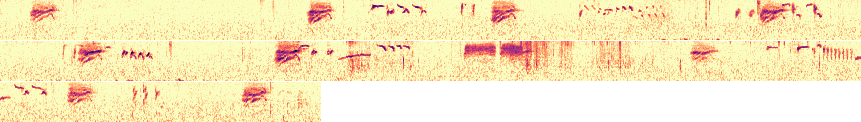

In [ ]:
query_rec = (user_recs
    .loc['20180805-60c3']  # BEWR
    .pipe(projection.slice_audio, 6.5)  # Re-denoise spectro
)
print(rec_str_line(query_rec))
display(rec_preds(query_rec, search, 15))
plot_spectro_micro(query_rec, features, wrap=True,
    audio=False,
    # limit_s=60,
)

 36.6  XC169517  BEWR  98.0s  B  call, song  United States/Arizona/Yavapai/Prescott National Forest (near  Prescott)  2014-03-10  Micah Riegner[by-nc-sa]


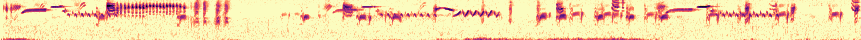

 36.8  XC217841  BEWR  80.0s  A  call  United States/California/San Diego County/near Dulzura/Otay Mountain  2013-03-28  Paul Marvin[by-nc-sa]


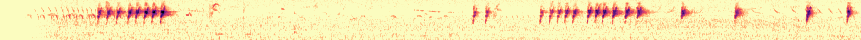

 37.0  XC282275  HOWR  230.7s  C  song  United States/New York/Nassau/Glen Cove  2015-05-03  Albert Lastukhin & Max Lastukhin[by-nc-sa]


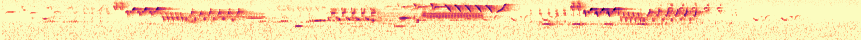

 37.3  XC89675  SOSP  51.7s  B  song  United States/Tennessee/Maryville/Kyker Bottoms Wildlife Refuge  2011-11-02  Mike Nelson[by-nc-nd]


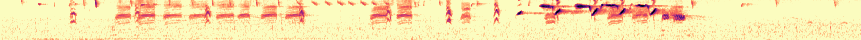

 37.6  XC158943  SPTO  84.4s  A  song  Canada/BC/Vancouver Island/Central Saanich/Island View Beach Regional Park  2012-07-07  Ian Cruickshank[by-nc-nd]


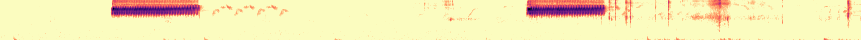

 37.7  XC231551  HOWR  25.9s  A  song  Mexico/Sinaloa/Barranca Rancho Liebre  2002-04-03  Peter Boesman[by-nc-nd]


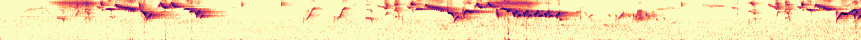

 37.7  XC334610  SOSP  95.6s  B  Sub-song, song  United States/California/Contra Costa County/Moraga  2016-09-11  Denise Wight[by-nc-sa]


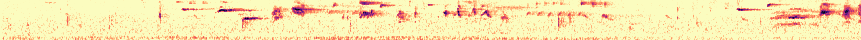

 38.2  XC142328  HOWR  26.7s  B  song  United States/Pennsylvania/Chester/Marsh Creek State Park  2013-07-07  Amy Davis[by-nc-sa]


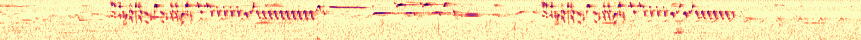

 38.6  XC159624  SOSP  92.3s  C  jumbled song  Canada/BC/Vancouver Island/Metchosin/Rocky Point Bird Observatory  2012-09-20  Ian Cruickshank[by-nc-nd]


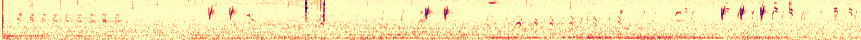

 39.0  XC358837  SOSP/maxillaris  31.3s  A  song  United States/California/Solano County/Grizzly Island Wildlife Area  2017-03-11  Jim Holmes[by-nc-sa]


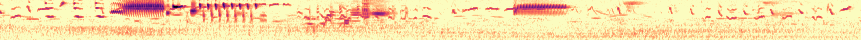

In [ ]:
for result in df_rows(
    rec_neighbors(projection, query_rec, xc_recs)
    [:10]
):
    print(xc_rec_str_line(result, ('dist', '%5.1f')))
    plot_spectro_micro(result, features,
        audio=False,
        wrap=False,
    )

# Q: Is dist(feat) actually useful? (part 1)
- Try SPTO as a simple starting point

20180429-dcf3  2018-04-29T16:35:13  SPTO  1.1s  SPTO spotted towhee song- kings rd+b2a088c8


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,CHSP,BEWR,OATI,SAPH,DEJU,SPTO,PAGP,AMGO,WATA,SPSA,NAWA,HOWR,WREN,CCSP,WEGR
p,0.0249,0.0242,0.023,0.0224,0.0223,0.0217,0.0212,0.0209,0.0209,0.0205,0.0205,0.0195,0.0195,0.0182,0.0182


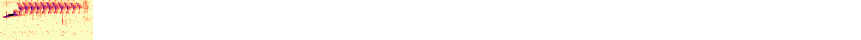

In [ ]:
# Slower SPTO trill
#   - Many more clean samples in this rec (all slow trills from same individual)
user_rec_spto_slow_clean = (user_recs
    .loc['20180429-dcf3']  # SPTO spotted towhee song- kings rd
    .pipe(projection.slice_spectro, 16.84, 17.92)
)
print(rec_str_line(user_rec_spto_slow_clean))
display(rec_preds(user_rec_spto_slow_clean, search, 15))
plot_spectro_micro(user_rec_spto_slow_clean, features,
    # audio=True,
)

20160716-6753  2016-07-16T16:47:33  SPTO  0.8s  SPTO spotted towhee+536867b1


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,WEWA,SPTO,PAWR,WIWR,BTAH,CHSP,ANHU,BTGN,BRSP,DOWO,MAWR,SACR,CCSP,VASW,NOPA
p,0.0284,0.0283,0.0278,0.0266,0.0266,0.0264,0.0257,0.0251,0.0241,0.0233,0.0232,0.0225,0.0217,0.0207,0.0198


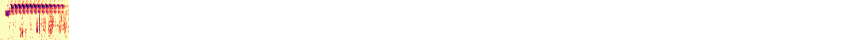

In [ ]:
# Faster SPTO trill
#   - Most samples are noisy in this rec, this is the cleanest one I found
user_rec_spto_fast_noisy = (user_recs
    .loc['20160716-6753']  # SPTO spotted towhee
    .pipe(projection.slice_spectro, 33.8, 34.6)
)
print(rec_str_line(user_rec_spto_fast_noisy))
display(rec_preds(user_rec_spto_fast_noisy, search, 15))
plot_spectro_micro(user_rec_spto_fast_noisy, features,
    # audio=True,
)

,species,n,subspecies,n,country,n,quality,n,type,n,(duration_s//30)*30,n
0,SPTO,521,,287,United States,350,A,234,song,289,0.0,198
1,,,montanus,95,Canada,113,B,198,call,127,30.0,172
2,,,megalonyx,34,Mexico,58,C,70,"call, song",19,60.0,81
3,,,falcinellus,33,,,D,8,Song,14,90.0,34
4,,,oregonus,29,,,E,2,"male, song",12,120.0,17
5,,,umbraticola,8,,,no score,9,mew calls,9,150.0,8
6,,,oaxacae,7,,,,,"call, male",5,180.0,4
7,,,magnirostris,5,,,,,high seep calls,3,210.0,1
8,,,arcticus,5,,,,,high mew calls,3,240.0,2
9,,,macronyx,4,,,,,Alarm call,2,360.0,2


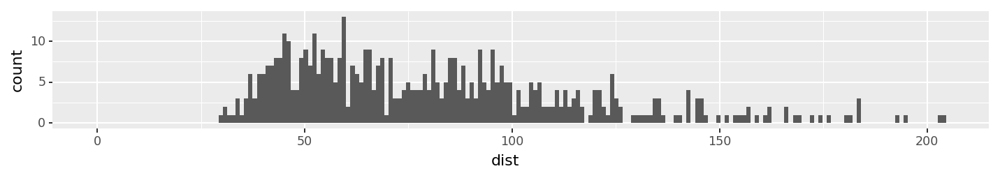

 36.8  XC325379  SPTO/falcinellus  2.9s  A  song  United States/California/Sacramento County/Mather Lake  2016-07-03  Jim Holmes[by-nc-sa]


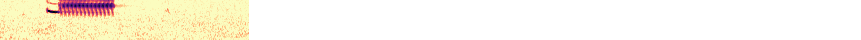

 37.2  XC100251  SPTO  18.5s  A  Song  United States/Point Loma Nazarene University  2012-04-22  Trent R. Stanley[by-nc-nd]


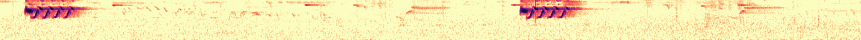

 39.0  XC325228  SPTO  21.7s  A  song  Canada/British Columbia/Saanichton  2016-04-07  James Bradley[by-nc-sa]


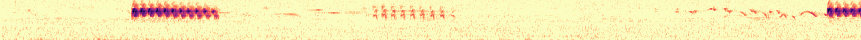

 39.5  XC179496  SPTO  32.7s  A  alarm call, call  United States/Arizona/Maricopa County/Mount Ord  2014-05-23  Tim Marquardt[by-nc-sa]


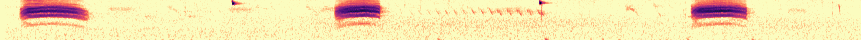

 40.7  XC159140  SPTO  16.2s  A  contact calls  Canada/BC/Vancouver Island/Victoria /Swan Lake  2012-08-05  Ian Cruickshank[by-nc-nd]


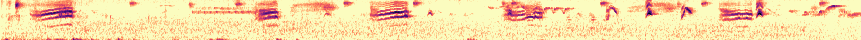

 41.3  XC37389  SPTO  26.1s  A  song  Canada/BC/Vancouver/north shore/UBC campus  2009-07-27  Bob Planqué[by-nc-sa]


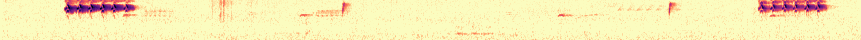

 41.5  XC228177  SPTO  13.5s  A  song  Mexico/Distrito F/La Cima  2003-04-18  Peter Boesman[by-nc-nd]


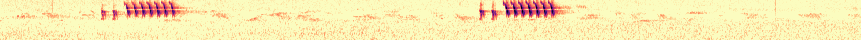

 42.4  XC159721  SPTO  8.1s  A  call  Canada/BC/Vancouver Island/Metchosin/Rocky Point Bird Observatory  2012-10-05  Ian Cruickshank[by-nc-nd]


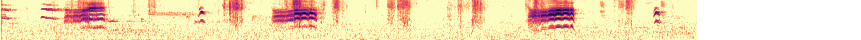

 42.6  XC126634  SPTO/megalonyx  20.4s  A  song  United States/San Bernardino Mountains/Santa Ana River Valley  1998-06-16  Richard E. Webster[by-nc-sa]


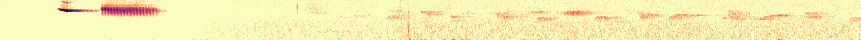

 43.1  XC408816  SPTO/clementae?  36.0s  A  song  United States/California/San Bernardino County/Rimforest  2015-05-09  Frank Lambert[by-nc-nd]


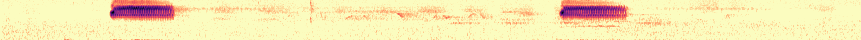

 43.4  XC159417  SPTO  66.2s  A  call  Canada/BC/Vancouver Island/Metchosin/Rocky Point Bird Observatory  2012-09-01  Ian Cruickshank[by-nc-nd]


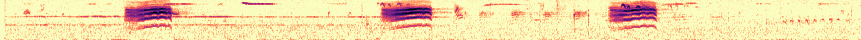

 44.7  XC32580  SPTO  32.7s  A  song  Mexico/Mexico City/Contadero  2009-04-14  manuel Grosselet[by-nc-nd]


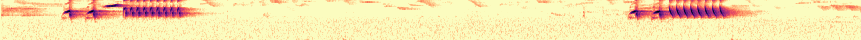

 44.9  XC181454  SPTO  33.5s  A  song  United States/Arizona/Maricopa County/Slate Creek Divide/Pigeon Spring  2014-06-07  Tim Marquardt[by-nc-sa]


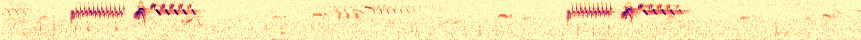

 45.9  XC228178  SPTO  11.9s  A  call  Mexico/Nuevo Leon/Cola de Caballo area  2000-05-30  Peter Boesman[by-nc-nd]


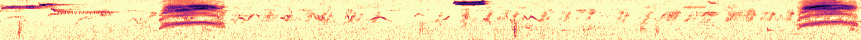

 46.0  XC73502  SPTO/oregonus  32.3s  A  Song  Canada/British Columbia/Victoria/Mount Douglas Park  2011-03-03  Ian Cruickshank[by-nc-nd]


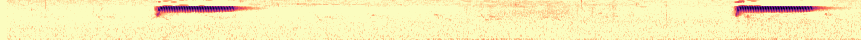

 46.0  XC159823  SPTO  20.0s  A  call  Canada/BC/Vancouver Island/Duncan/Quamichan Lake  2013-01-01  Ian Cruickshank[by-nc-nd]


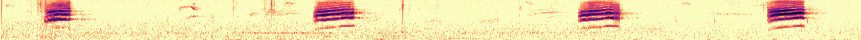

 46.1  XC158976  SPTO  45.5s  A  song  Canada/BC/Vancouver Island/Victoria/Swan Lake  2012-07-11  Ian Cruickshank[by-nc-nd]


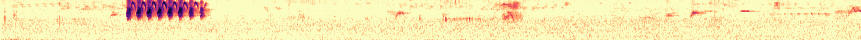

 46.8  XC128909  SPTO  39.6s  A  song  United States/Cerro Alto Campground/California/Atascadero  2013-04-06  Thomas G. Graves[by-nc-sa]


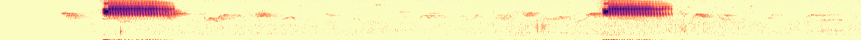

 47.5  XC158934  SPTO  53.5s  A  song  Canada/BC/Vancouver Island/Central Saanich/Island View Beach Regional Park  2012-07-07  Ian Cruickshank[by-nc-nd]


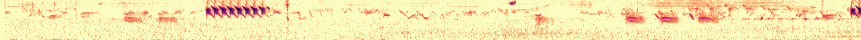

 48.4  XC158913  SPTO  109.9s  A  song and thin seep calls   Canada/BC/Vancouver Island/Victoria/Swan Lake  2012-07-04  Ian Cruickshank[by-nc-nd]


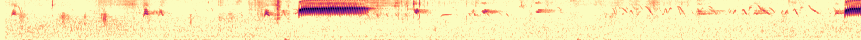

In [ ]:
query_rec = user_rec_spto_slow_clean
# query_rec = user_rec_spto_fast_noisy
results = rec_neighbors(projection, query_rec, (xc_recs
    .query("species == 'SPTO'")
    # .query("quality.isin(['A'])")
))
display(
    df_value_counts(results, exprs=[
        'species',
        'subspecies',
        'country',
        ('quality', dict(sort_values=True)),
        'type',
        ('(duration_s//30)*30', dict(sort_values=True)),
        # 'locality',
        # 'recordist',
        # ('date.dt.year', dict(sort_values=True, ascending=False)),
        # ("time.str.slice(0, 2)"),
    ]),
)
repr(results
    .pipe(ggplot) + aes(x='dist') + geom_histogram(bins=200)
    + expand_limits(x=0)
)
for result in df_rows(results
    .query("quality.isin(['A'])")
    # [:0]
    [:20]
):
    print(xc_rec_str_line(result, ('dist', '%5.1f')))
    plot_spectro_micro(result, features,
        # audio=True,
    )

234
XC112080  SPTO/montanus  176.2s  A  song  United States/Chiricahua Mountains/Crest Trail  2012-07-22  Richard E Webster[by-nc-nd]


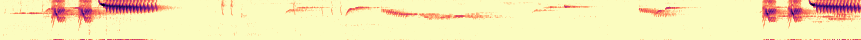

XC35906  SPTO/oregonus  45.8s  A  Alarm call  United States/WA/King Co./NE Union Hill Rd  2009-06-14  Tayler Brooks[by-nc-nd]


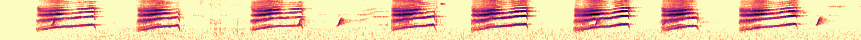

XC376224  SPTO  22.3s  A  song  United States/Colorado/Boulder County/El Dorado Spgs/Spring Brook Trail  2017-06-18  Ted Floyd[by-nc-sa]


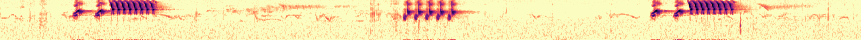

XC312024  SPTO  33.8s  A  alarm call, song  United States/Cerro Alto Campground/California/Atascadero  2016-04-11  Thomas G. Graves[by-nc-sa]


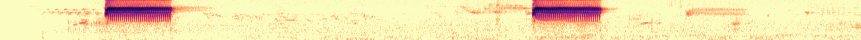

XC127015  SPTO/montanus  42.8s  A  call, song  United States/Inyo County/Death Valley National Park/Hunter Mountain  2000-05-21  Richard E. Webster[by-nc-sa]


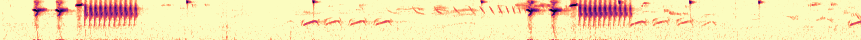

XC126691  SPTO/montanus  59.0s  A  song  United States/Inyo County/Death Valley National Park/Hunter Mountain  2000-05-21  Richard E. Webster[by-nc-sa]


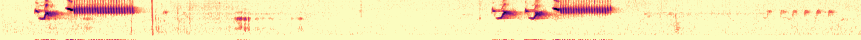

XC324965  SPTO  3.3s  A  song  United States/Colorado/Boulder County/El Dorado Spgs/Spring Brook Trail  2016-06-30  Ted Floyd[by-nc-sa]


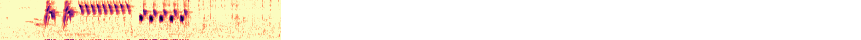

XC126661  SPTO/falcinellus  22.3s  A  song  United States/California/Inyo/Sage Flats Road  2000-06-17  Richard E. Webster[by-nc-sa]


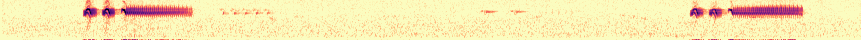

In [ ]:
for rec in df_rows(xc_recs
    .query("species == 'SPTO'")
    .query("quality == 'A'")
    .pipe(tap, lambda df: print(len(df)))
    .sample(random_state=0,
        n=8,
    )
):
    print(xc_rec_str_line(rec))
    plot_spectro_micro(rec, features,
        # audio=True,
    )

# Try ordering by something and visualizing the thumbs

A           234
B           198
C            70
D             8
E             2
no score      9
Name: quality, dtype: int64

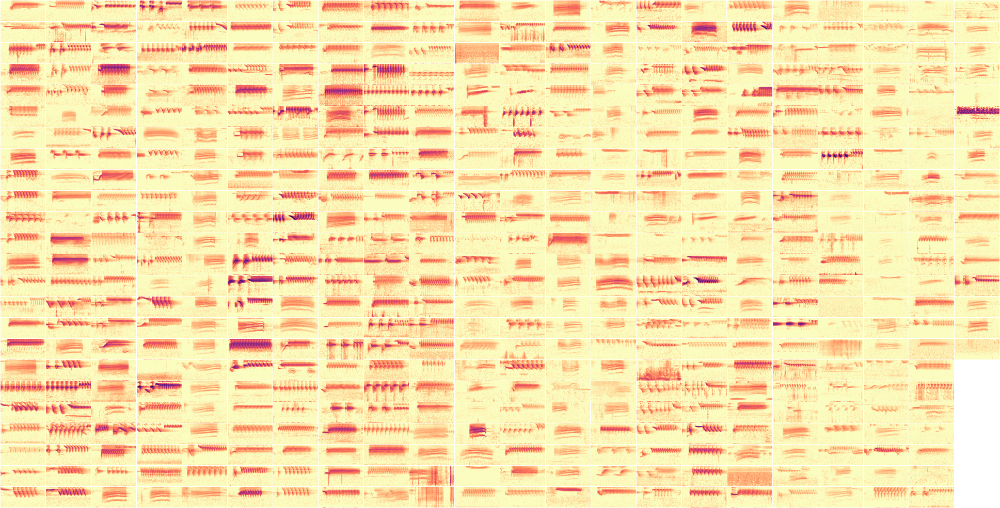

In [ ]:
# All SPTO ordered by quality [but you can't see the breaks]
#   - Slow (~12s)
(xc_recs
    .query("species == 'SPTO'")
    .sort_values(['quality', 'date'], ascending=[True, False])
    # [:10]
    .pipe(df_inspect, lambda df: df.quality.value_counts().sort_index())
    .pipe(plot_thumb_grid, features, cols=None)
)

A           234
B             0
C             0
D             0
E             0
no score      0
Name: quality, dtype: int64

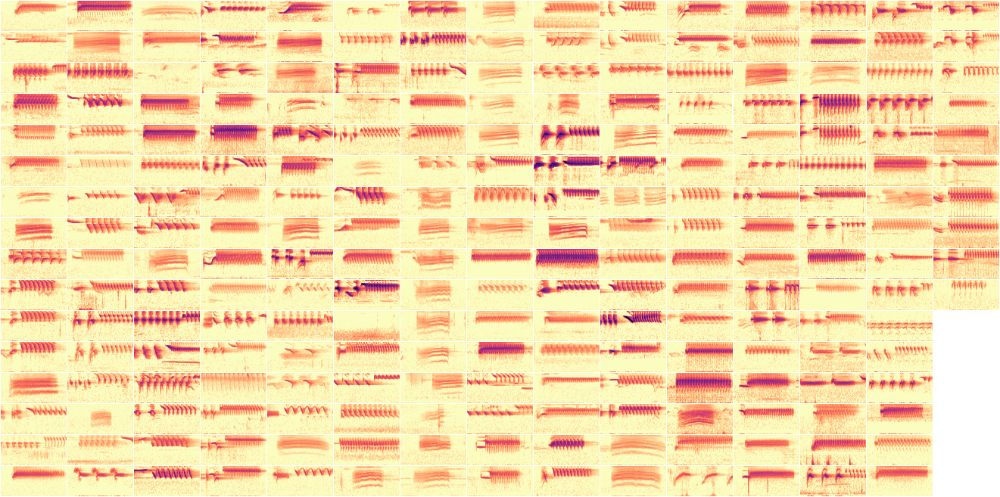

In [ ]:
# All SPTO quality='A'
(xc_recs
    .query("species == 'SPTO'")
    .query("quality == 'A'")
    .sort_values(['date'], ascending=False)
    # [:10]
    .pipe(df_inspect, lambda df: df.quality.value_counts().sort_index())
    .pipe(plot_thumb_grid, features, cols=None)
)

## Q: Order by dist to an example query
- A: Not very compelling...

XC312024  SPTO  33.8s  A  alarm call, song  United States/Cerro Alto Campground/California/Atascadero  2016-04-11  Thomas G. Graves[by-nc-sa]


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,SPTO,NRWS,RWBL,LOSH,TRES,RIRA,HOWR,BEKI,YRWA,BTGN,GREG,GRFL,SUTA,LISP,CATH
p,0.0481,0.0481,0.0475,0.047,0.0441,0.043,0.0427,0.0426,0.0419,0.0406,0.0354,0.0316,0.031,0.0302,0.0292


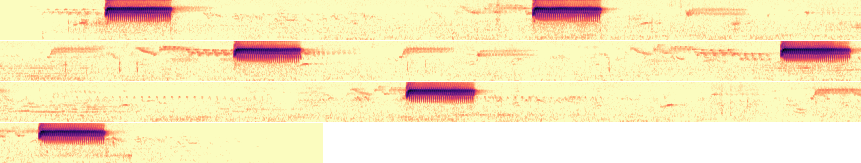

In [ ]:
query_rec = (xc_recs
    .query("xc_id == 312024")
    .iloc[0]
)
print(xc_rec_str_line(query_rec))
display(rec_preds(query_rec, search, 15))
plot_spectro_micro(query_rec, features, wrap=True,
    # audio=True,
    # limit_s=60,
)

A           234
B             0
C             0
D             0
E             0
no score      0
Name: quality, dtype: int64

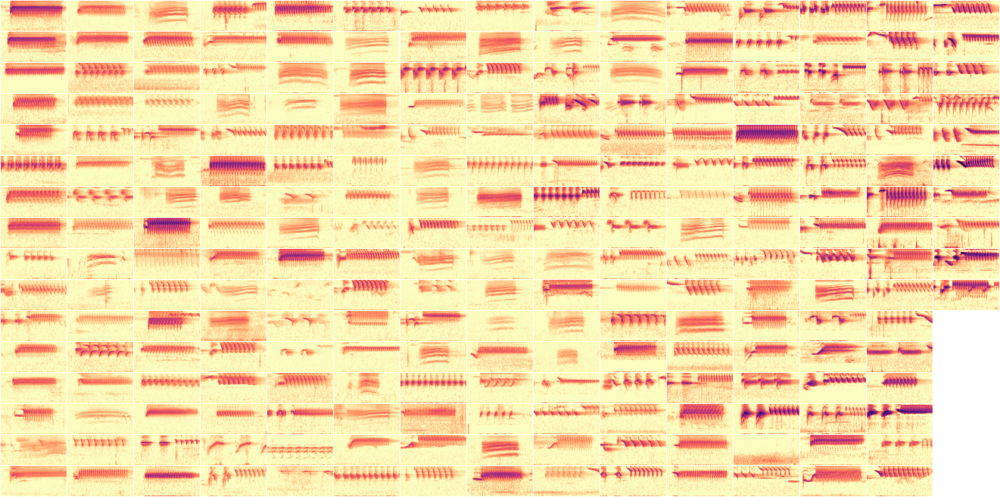

In [ ]:
(
    rec_neighbors(projection, query_rec, xc_recs)
    .query("species == 'SPTO'")
    .query("quality == 'A'")
    # [:12]
    .pipe(df_inspect, lambda df: df.quality.value_counts().sort_index())
    .pipe(plot_thumb_grid, features, cols=None)
)

## Q: Order SPTO by norm(pca(xc_recs_probs, 2)), around the 1D unit circle (S^1)
- No query_rec, just walk the circle
- A: No strong conclusion...

In [ ]:
xc_recs_probs = (xc_recs
    .assign(probs=lambda df: list(search.classifier_.predict_proba(Search.X(df))))
)

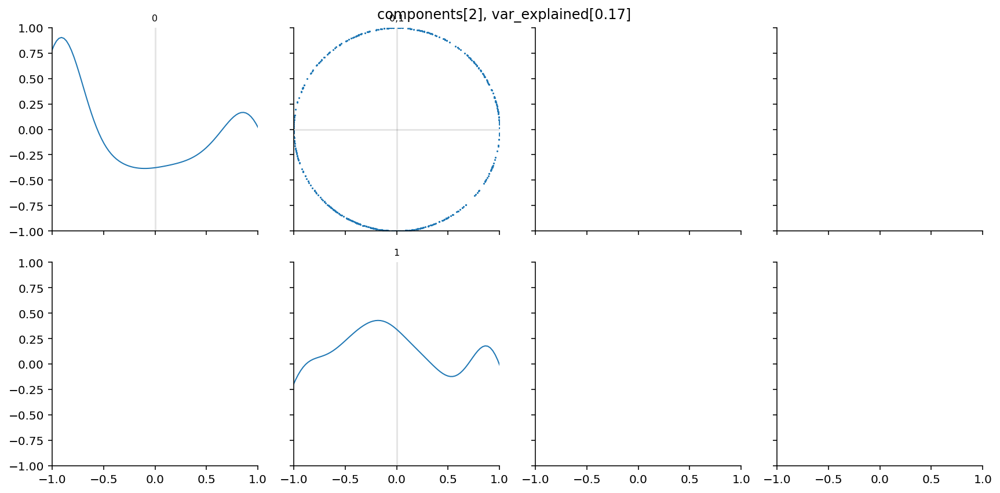

In [ ]:
df = (xc_recs_probs
    .query("species == 'SPTO'")  # PCA only SPTO (not multiple species) to capture only the variance that matters
)
probs_X = lambda df: np.array(list(df.probs))
pca = (
    sk.pipeline.make_pipeline(
        sk.preprocessing.StandardScaler(with_mean=True, with_std=False),  # De-mean
        sk.decomposition.PCA(
            n_components=2,
        ),
        sk.preprocessing.Normalizer(),  # No effect iff pca components explain 100% of var (n_components=None)
    )
    .fit(probs_X(df))
)
_pca = dict(pca.steps)['pca']  # [TODO Why does _pca.transform i/o pca.transform give a cloud that looks more centered?]
df_pca = (df
    .pipe(lambda df: (
        DF(pca.transform(probs_X(df)), columns=[f'x{i}' for i in range(len(_pca.components_))])
        .join(df.reset_index())
        .set_index(df.index)
    ))
)
plot_all_projections(
    df_pca,
    ndims=min(5, len(_pca.components_)),
    ncols=4, nrows=2,
    dim_name='x%s',
    suptitle='components[%s], var_explained[%.2g]' % (len(_pca.components_), _pca.explained_variance_ratio_.sum()),
    diag_hack=True,
)

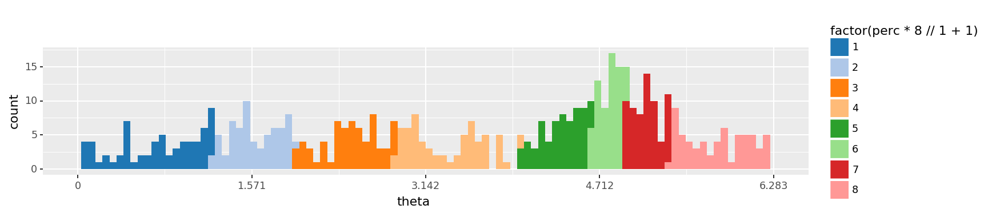

<ggplot: (397272703)>

In [ ]:
# Compute theta (1D param for norm(pca(2)))
#   - Manually rotate to pick the break between start and end
theta_rotate = np.pi * 1/2
df_pca = (df_pca
    # [:10]
    .assign(theta=lambda df: (
        (np.angle(df.x0 + df.x1*1j) + theta_rotate) % (2*np.pi)
    ))
    # Compute perc, so we can visually match mass with grid below (at least very roughly)
    .sort_values('theta').assign(perc=lambda df: (
        df.reset_index(drop=True).reset_index().index / len(df)
    ))
    .pipe(df_reorder_cols, first=['theta'])
    # .pipe(df_inspect, lambda df: qplot(data=df, x='theta', bins=100, xlim=(-np.pi,np.pi)))
    .pipe(df_inspect, lambda df: (df
        .pipe(ggplot)
        + aes(x='theta')
        + geom_histogram(bins=100)
        + aes(fill='factor(perc * 8 // 1 + 1)') + scale_fill_cmap_d('tab20')
        + scale_x_continuous(limits=(0, 2*np.pi), breaks=np.linspace(0, 2*np.pi, 5))
        + theme_figsize(aspect=1/6)
    ))
)

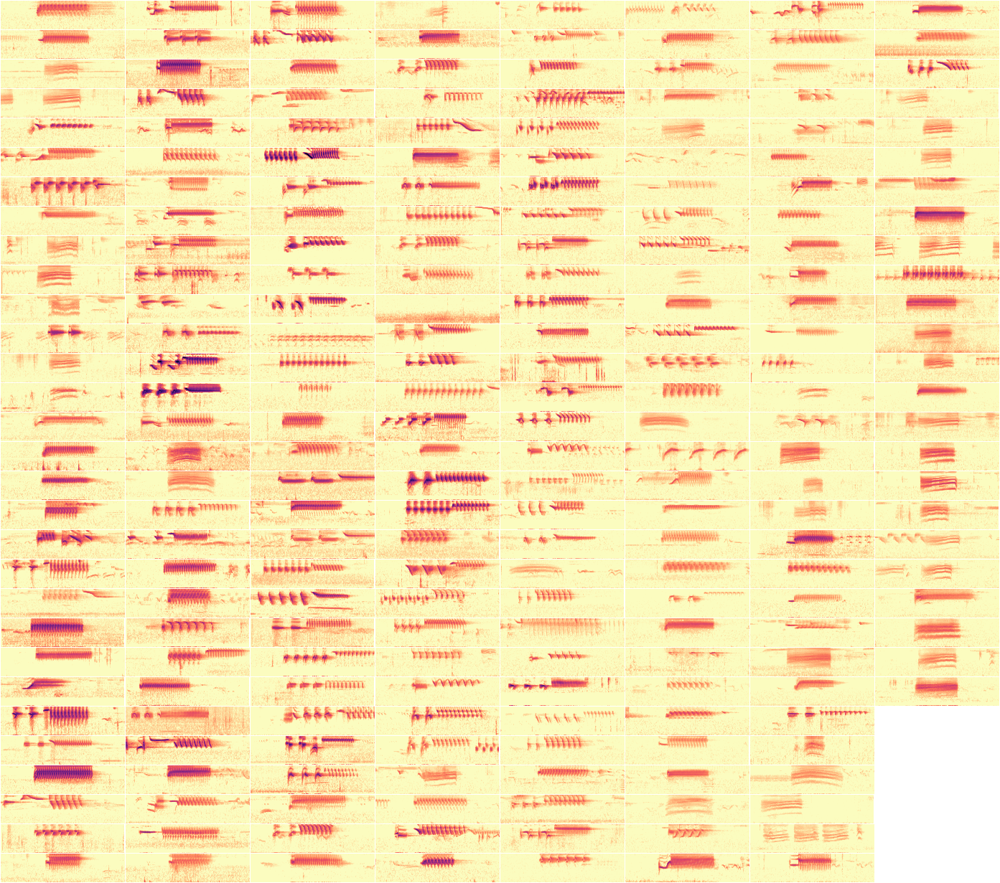

In [ ]:
(df_pca
    .query("quality == 'A'")
    .sort_values('theta')
    # [:12]
    # .pipe(df_inspect, lambda df: df.quality.value_counts().sort_index())
    .pipe(plot_thumb_grid, features, thumb_s=2, cols=8)
)

## Q: Order HOWR by norm(pca(xc_recs_probs, 2)), around the 1D unit circle (S^1)
- No query_rec, just walk the circle
- A: TODO

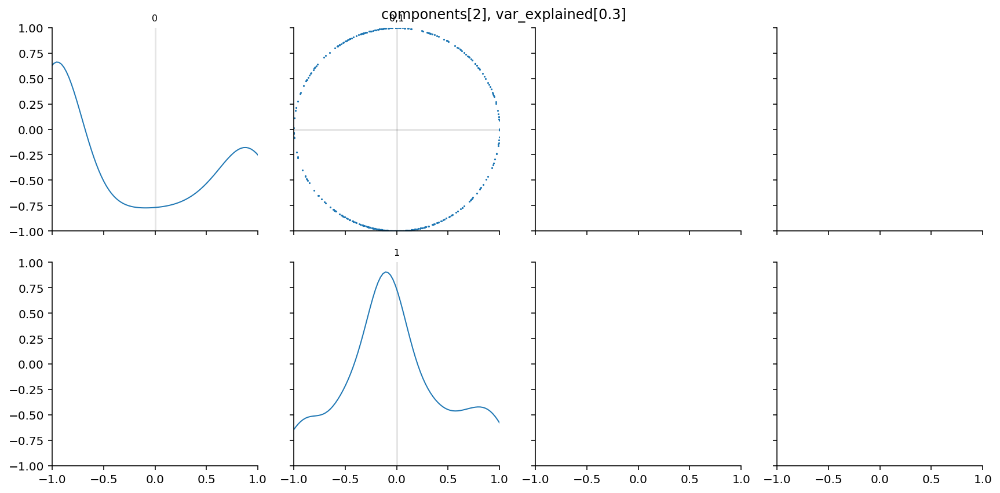

In [ ]:
df = (xc_recs_probs
    .query("species == 'HOWR'")
)
probs_X = lambda df: np.array(list(df.probs))
pca = (
    sk.pipeline.make_pipeline(
        sk.preprocessing.StandardScaler(with_mean=True, with_std=False),  # De-mean
        sk.decomposition.PCA(
            n_components=2,
        ),
        # Outputs are already normalized if pca components explain 100% of var (n_components=None), but not if <100%
        sk.preprocessing.Normalizer(),
    )
    .fit(probs_X(df))
)
_pca = dict(pca.steps)['pca']  # [Why does _pca.transform i/o pca.transform give a cloud that looks more centered?]
df_pca = (df
    .pipe(lambda df: (
        DF(pca.transform(probs_X(df)), columns=[f'x{i}' for i in range(len(_pca.components_))])
        .join(df.reset_index())
        .set_index(df.index)
    ))
)
plot_all_projections(
    df_pca,
    ndims=min(5, len(_pca.components_)),
    ncols=4, nrows=2,
    dim_name='x%s',
    suptitle='components[%s], var_explained[%.2g]' % (len(_pca.components_), _pca.explained_variance_ratio_.sum()),
    diag_hack=True,
)

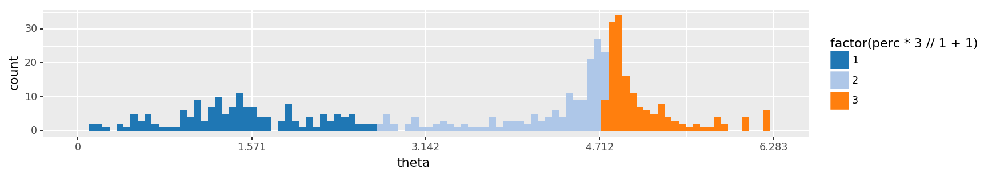

<ggplot: (397121940)>

In [ ]:
# Compute theta (1D param for norm(pca(2)))
#   - Manually rotate to pick the break between start and end
theta_rotate = np.pi * 1/2
df_pca = (df_pca
    # [:10]
    .assign(theta=lambda df: (
        (np.angle(df.x0 + df.x1*1j) + theta_rotate) % (2*np.pi)
    ))
    # Compute perc, so we can visually match mass with grid below (at least very roughly)
    .sort_values('theta').assign(perc=lambda df: (
        df.reset_index(drop=True).reset_index().index / len(df)
    ))
    .pipe(df_reorder_cols, first=['theta'])
    # .pipe(df_inspect, lambda df: qplot(data=df, x='theta', bins=100, xlim=(-np.pi,np.pi)))
    .pipe(df_inspect, lambda df: (df
        .pipe(ggplot)
        + aes(x='theta')
        + geom_histogram(bins=100)
        + aes(fill='factor(perc * 3 // 1 + 1)') + scale_fill_cmap_d('tab20')
        + scale_x_continuous(limits=(0, 2*np.pi), breaks=np.linspace(0, 2*np.pi, 5))
        + theme_figsize(aspect=1/6)
    ))
)

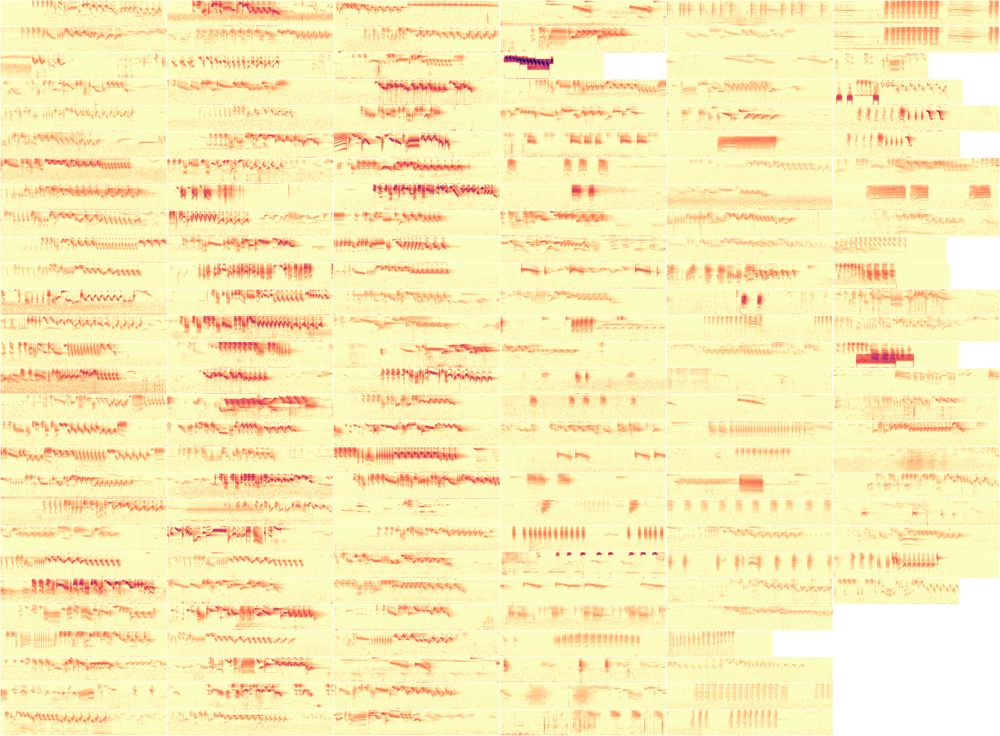

In [ ]:
(df_pca
    .query("quality == 'A'")
    .sort_values('theta')
    # [:12]
    # .pipe(df_inspect, lambda df: df.quality.value_counts().sort_index())
    .pipe(plot_thumb_grid, features, thumb_s=3, cols=6)
)

## Q: Order BEWR by norm(pca(xc_recs_probs, 2)), around the 1D unit circle (S^1)
- No query_rec, just walk the circle
- A: TODO

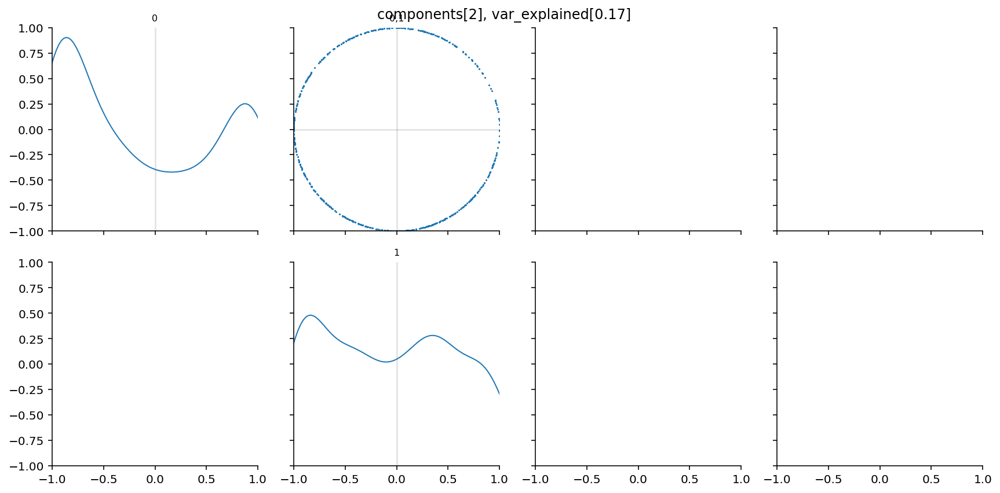

In [ ]:
df = (xc_recs_probs
    .query("species == 'BEWR'")
)
probs_X = lambda df: np.array(list(df.probs))
pca = (
    sk.pipeline.make_pipeline(
        sk.preprocessing.StandardScaler(with_mean=True, with_std=False),  # De-mean
        sk.decomposition.PCA(
            n_components=2,
        ),
        # Outputs are already normalized if pca components explain 100% of var (n_components=None), but not if <100%
        sk.preprocessing.Normalizer(),
    )
    .fit(probs_X(df))
)
_pca = dict(pca.steps)['pca']  # [Why does _pca.transform i/o pca.transform give a cloud that looks more centered?]
df_pca = (df
    .pipe(lambda df: (
        DF(pca.transform(probs_X(df)), columns=[f'x{i}' for i in range(len(_pca.components_))])
        .join(df.reset_index())
        .set_index(df.index)
    ))
)
plot_all_projections(
    df_pca,
    ndims=min(5, len(_pca.components_)),
    ncols=4, nrows=2,
    dim_name='x%s',
    suptitle='components[%s], var_explained[%.2g]' % (len(_pca.components_), _pca.explained_variance_ratio_.sum()),
    diag_hack=True,
)

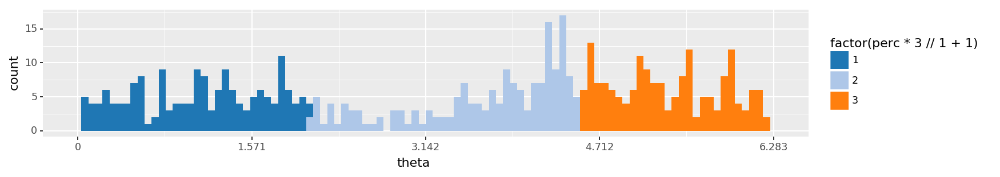

<ggplot: (397272738)>

In [ ]:
# Compute theta (1D param for norm(pca(2)))
#   - Manually rotate to pick the break between start and end
theta_rotate = np.pi * 1/2
df_pca = (df_pca
    # [:10]
    .assign(theta=lambda df: (
        (np.angle(df.x0 + df.x1*1j) + theta_rotate) % (2*np.pi)
    ))
    # Compute perc, so we can visually match mass with grid below (at least very roughly)
    .sort_values('theta').assign(perc=lambda df: (
        df.reset_index(drop=True).reset_index().index / len(df)
    ))
    .pipe(df_reorder_cols, first=['theta'])
    # .pipe(df_inspect, lambda df: qplot(data=df, x='theta', bins=100, xlim=(-np.pi,np.pi)))
    .pipe(df_inspect, lambda df: (df
        .pipe(ggplot)
        + aes(x='theta')
        + geom_histogram(bins=100)
        + aes(fill='factor(perc * 3 // 1 + 1)') + scale_fill_cmap_d('tab20')
        + scale_x_continuous(limits=(0, 2*np.pi), breaks=np.linspace(0, 2*np.pi, 5))
        + theme_figsize(aspect=1/6)
    ))
)

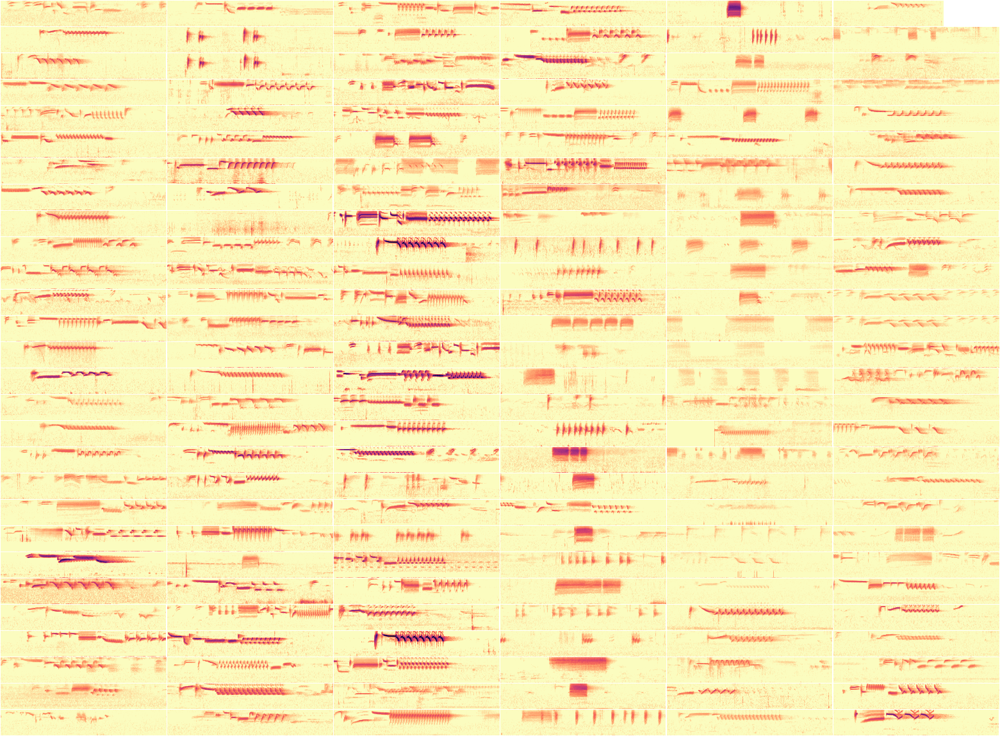

In [ ]:
(df_pca
    .query("quality == 'A'")
    .sort_values('theta')
    # [:12]
    # .pipe(df_inspect, lambda df: df.quality.value_counts().sort_index())
    .pipe(plot_thumb_grid, features, thumb_s=3, cols=6)
)

## Q: Order SOSP by norm(pca(xc_recs_probs, 2)), around the 1D unit circle (S^1)
- No query_rec, just walk the circle
- A: TODO

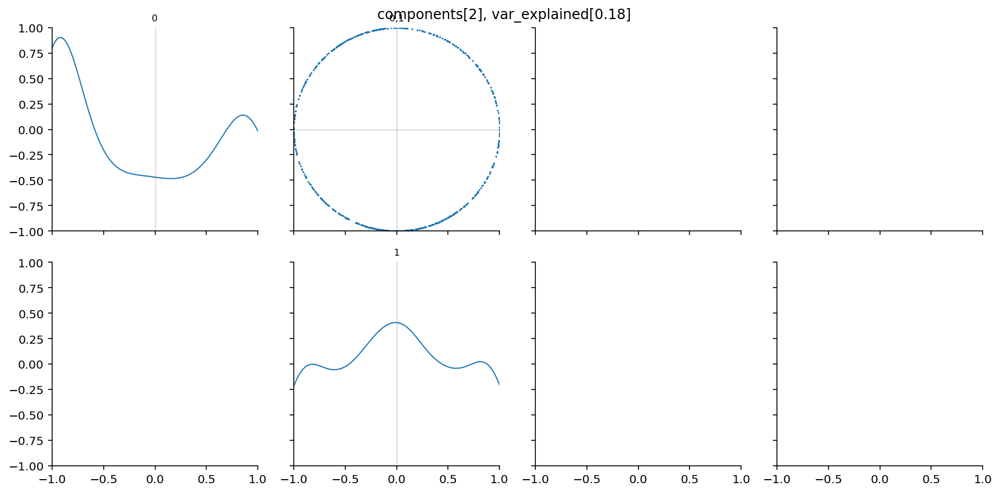

In [ ]:
df = (xc_recs_probs
    .query("species == 'SOSP'")
)
probs_X = lambda df: np.array(list(df.probs))
pca = (
    sk.pipeline.make_pipeline(
        sk.preprocessing.StandardScaler(with_mean=True, with_std=False),  # De-mean
        sk.decomposition.PCA(
            n_components=2,
        ),
        # Outputs are already normalized if pca components explain 100% of var (n_components=None), but not if <100%
        sk.preprocessing.Normalizer(),
    )
    .fit(probs_X(df))
)
_pca = dict(pca.steps)['pca']  # [Why does _pca.transform i/o pca.transform give a cloud that looks more centered?]
df_pca = (df
    .pipe(lambda df: (
        DF(pca.transform(probs_X(df)), columns=[f'x{i}' for i in range(len(_pca.components_))])
        .join(df.reset_index())
        .set_index(df.index)
    ))
)
plot_all_projections(
    df_pca,
    ndims=min(5, len(_pca.components_)),
    ncols=4, nrows=2,
    dim_name='x%s',
    suptitle='components[%s], var_explained[%.2g]' % (len(_pca.components_), _pca.explained_variance_ratio_.sum()),
    diag_hack=True,
)

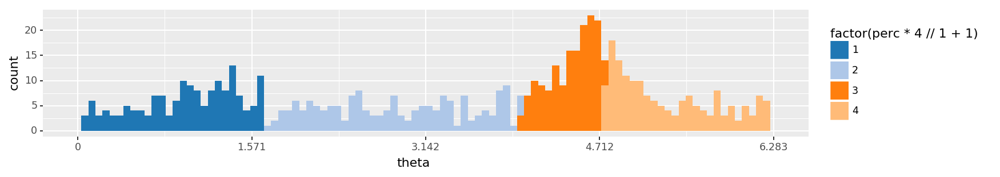

<ggplot: (399357672)>

In [ ]:
# Compute theta (1D param for norm(pca(2)))
#   - Manually rotate to pick the break between start and end
theta_rotate = np.pi * 1/2
df_pca = (df_pca
    # [:10]
    .assign(theta=lambda df: (
        (np.angle(df.x0 + df.x1*1j) + theta_rotate) % (2*np.pi)
    ))
    # Compute perc, so we can visually match mass with grid below (at least very roughly)
    .sort_values('theta').assign(perc=lambda df: (
        df.reset_index(drop=True).reset_index().index / len(df)
    ))
    .pipe(df_reorder_cols, first=['theta'])
    # .pipe(df_inspect, lambda df: qplot(data=df, x='theta', bins=100, xlim=(-np.pi,np.pi)))
    .pipe(df_inspect, lambda df: (df
        .pipe(ggplot)
        + aes(x='theta')
        + geom_histogram(bins=100)
        + aes(fill='factor(perc * 4 // 1 + 1)') + scale_fill_cmap_d('tab20')
        + scale_x_continuous(limits=(0, 2*np.pi), breaks=np.linspace(0, 2*np.pi, 5))
        + theme_figsize(aspect=1/6)
    ))
)

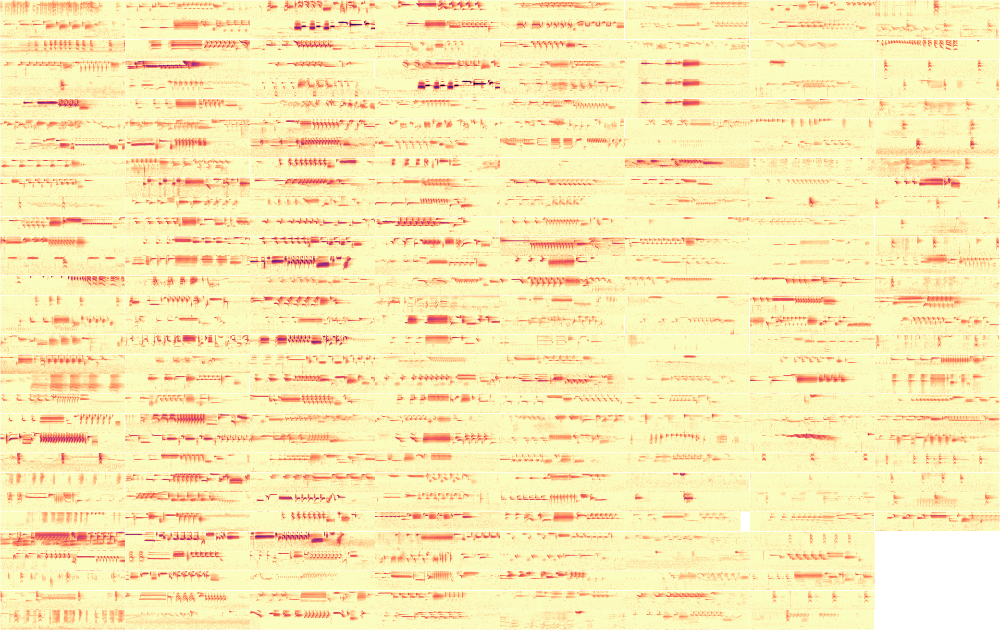

In [ ]:
(df_pca
    .query("quality == 'A'")
    .sort_values('theta')
    # [:12]
    # .pipe(df_inspect, lambda df: df.quality.value_counts().sort_index())
    .pipe(plot_thumb_grid, features, thumb_s=3, cols=8)
)

## Q: Order PSFL by norm(pca(xc_recs_probs, 2)), around the 1D unit circle (S^1)
- No query_rec, just walk the circle
- A: TODO

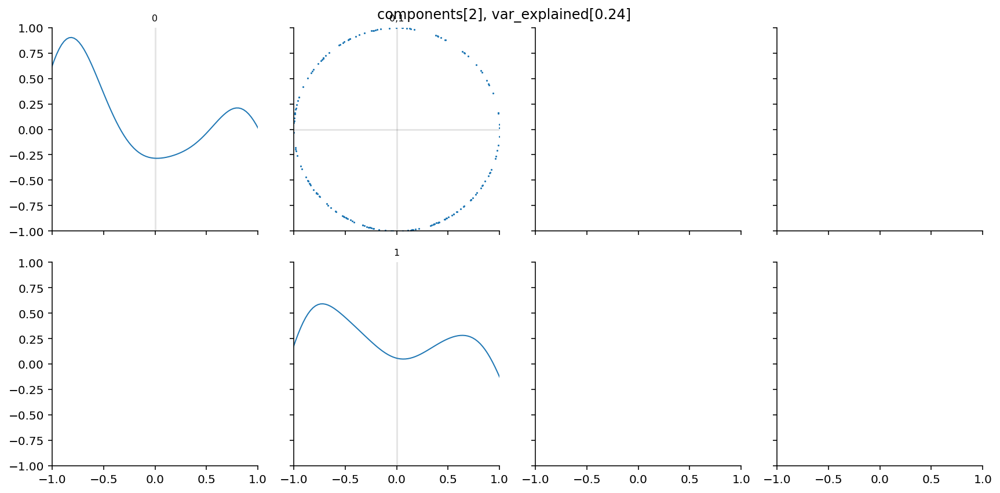

In [ ]:
df = (xc_recs_probs
    .query("species == 'PSFL'")
)
probs_X = lambda df: np.array(list(df.probs))
pca = (
    sk.pipeline.make_pipeline(
        sk.preprocessing.StandardScaler(with_mean=True, with_std=False),  # De-mean
        sk.decomposition.PCA(
            n_components=2,
        ),
        # Outputs are already normalized if pca components explain 100% of var (n_components=None), but not if <100%
        sk.preprocessing.Normalizer(),
    )
    .fit(probs_X(df))
)
_pca = dict(pca.steps)['pca']  # [Why does _pca.transform i/o pca.transform give a cloud that looks more centered?]
df_pca = (df
    .pipe(lambda df: (
        DF(pca.transform(probs_X(df)), columns=[f'x{i}' for i in range(len(_pca.components_))])
        .join(df.reset_index())
        .set_index(df.index)
    ))
)
plot_all_projections(
    df_pca,
    ndims=min(5, len(_pca.components_)),
    ncols=4, nrows=2,
    dim_name='x%s',
    suptitle='components[%s], var_explained[%.2g]' % (len(_pca.components_), _pca.explained_variance_ratio_.sum()),
    diag_hack=True,
)

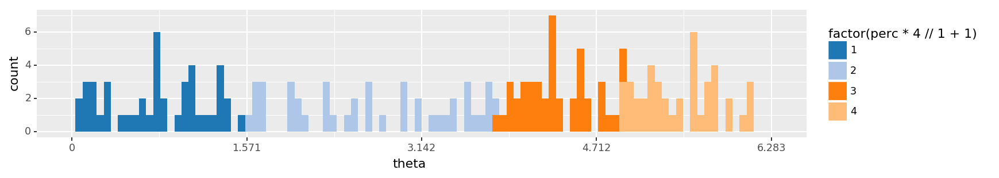

<ggplot: (-9223372036457493686)>

In [ ]:
# Compute theta (1D param for norm(pca(2)))
#   - Manually rotate to pick the break between start and end
theta_rotate = np.pi * 1/2
df_pca = (df_pca
    # [:10]
    .assign(theta=lambda df: (
        (np.angle(df.x0 + df.x1*1j) + theta_rotate) % (2*np.pi)
    ))
    # Compute perc, so we can visually match mass with grid below (at least very roughly)
    .sort_values('theta').assign(perc=lambda df: (
        df.reset_index(drop=True).reset_index().index / len(df)
    ))
    .pipe(df_reorder_cols, first=['theta'])
    # .pipe(df_inspect, lambda df: qplot(data=df, x='theta', bins=100, xlim=(-np.pi,np.pi)))
    .pipe(df_inspect, lambda df: (df
        .pipe(ggplot)
        + aes(x='theta')
        + geom_histogram(bins=100)
        + aes(fill='factor(perc * 4 // 1 + 1)') + scale_fill_cmap_d('tab20')
        + scale_x_continuous(limits=(0, 2*np.pi), breaks=np.linspace(0, 2*np.pi, 5))
        + theme_figsize(aspect=1/6)
    ))
)

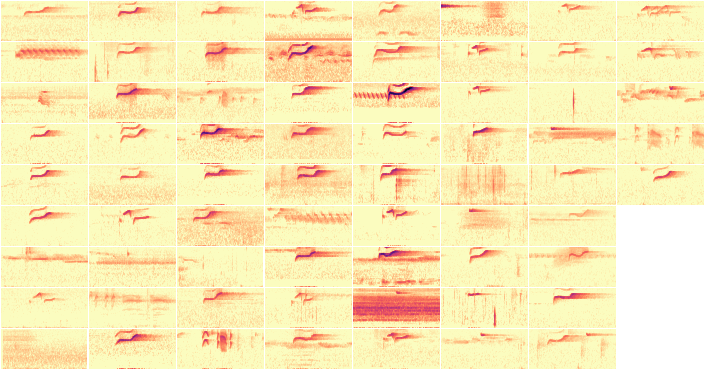

In [ ]:
(df_pca
    .query("quality == 'A'")
    .sort_values('theta')
    # [:12]
    # .pipe(df_inspect, lambda df: df.quality.value_counts().sort_index())
    .pipe(plot_thumb_grid, features, thumb_s=1, cols=8)
)

# TODO Got a baseline! Next, try with the pca spaces.
- [ ] (!) How well does ranking even need to work, given that many species won't have that many recs?
- [x] Plot the pca(2) circle (forget the query_rec, just plot in order around the circle, starting anywhere)
- [ ] Plot query_rec dists in pca(3), pca(4), etc.
- [ ] Think harder...
    - [x] Pull better models? (these aren't trained on much data)
    - [x] Train some l1 models? (maybe a rabbithole)
    - ...